This notebook contains all basic unsupervised analysis of the data, preparing data objects that are used by other notebooks that perform specialised analyses.

# Load Packages and Set Global Variables

All variable definitions necessary to customize notebook execution are included in this section.

<a id="imports"></a>

## Imports and Settings

In [1]:
import anndata
import cellrank as cr
import numpy as np
import scanpy as sc
import scvelo as scv
import sys
import pandas as pd
import pickle
import seaborn as sb
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors

print(sc.__version__)
print(anndata.__version__)

np.random.seed(seed=1)

1.8.1
0.7.6


Set up paths to all data resources used throughout notebook here:

In [2]:
sc.settings.verbosity = 3 # amount of output

root_dir = '.'

dir_in = root_dir + 'data/'
base_dir = root_dir + 'results/'
dir_gene_sets = root_dir + 'data/gene_sets/MSigDBlists/'
dir_cc_gene_set = root_dir + 'data/gene_sets/regev_lab_cell_cycle_genes_10X.txt'

# Make sure that these folders exist:
dir_out = base_dir + 'figures/multiome/'
dir_tables = base_dir + 'tables/multiome/'
dir_anndata = base_dir + 'anndata/multiome/'
dir_de = base_dir + 'de/multiome/'

# Set paths in which data lies:
fn_h5ad_72h = dir_in + "geo/ascl1_ascl1mutant_myod1_filtered_feature_bc_matrix.h5"
fn_mtx_soupx = dir_in + 'soupx/P21060'

fn_atac_bed = dir_in + "atac/atac_peak_annotation.tsv"

sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80, scanpy=True)
sc.settings.figdir = dir_out
scv.settings.figdir = dir_out
print(sys.version)

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.7.6
scanpy      1.8.1
sinfo       0.3.4
-----
PIL                         8.3.2
anyio                       NA
appnope                     0.1.2
attr                        21.2.0
babel                       2.9.1
backcall                    0.2.0
beta_ufunc                  NA
binom_ufunc                 NA
cellrank                    1.4.0
certifi                     2021.05.30
cffi                        1.14.6
chardet                     4.0.0
charset_normalizer          2.0.4
cloudpick

In [3]:
constructs = [
    "synAscl1",
    "synMyod1",
]
constructs_dict = {
    "synAscl1": ['synAscl1'],
    "synMyod1": ['synMyod1'],
}
constructs_color = [
    "DsRed",
    "AcGFP1",
    "EBFP2"
]
constructs_color_dict = {
    "DsRed": ["DsRed-minus-gn", "DsRed-plus-gn"],
    "AcGFP1": ["AcGFP1-minus-gn", "AcGFP1-plus-gn"],
    "EBFP2": ["EBFP2-minus-gn", "EBFP2-plus-gn"],
}
endogenous_genes = [
    "Ascl1",
    "Myod1",
]

<a id="Global"></a>

## Global Variables

Set whether anndata objects are recomputed or loaded from cache.

In [4]:
bool_recomp = True

Set whether clustering is recomputed or loaded from saved .obs file. Loading makes sense if the clustering changes due to a change in scanpy or one of its dependencies and the number of clusters or the cluster labels change accordingly.

In [5]:
bool_recluster = False

Set whether cluster cache is overwritten. Note that the cache exists for reproducibility of clustering, see above.

In [6]:
bool_write_cluster_cache = False

Set whether to produce plots, set to False for test runs.

In [7]:
bool_plot = True

Set colors for UMAP:

In [8]:
colors2 = plt.cm.Reds(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

# Loading Data, Quality Control and Preprocessing

## Loading

Cellranger aligned mRNA and ATAC counts:

In [9]:
adata_raw = sc.read_10x_h5(fn_h5ad_72h, gex_only=False)

reading /Users/davfischer/Documents/science/collideseq/data/P21060/cr_count/filtered_feature_bc_matrix.h5


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


 (0:00:06)


In [10]:
adata_raw

AnnData object with n_obs × n_vars = 7871 × 267962
    var: 'gene_ids', 'feature_types', 'genome'

In [11]:
adata_raw.var.loc[adata_raw.var["feature_types"].values == "Gene Expression", :].iloc[-10:, :]

,gene_ids,feature_types,genome
Vmn2r122,ENSMUSG00000096730,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
CAAA01147332.1,ENSMUSG00000095742,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
AcGFP1-plus-gn,AcGFP1-plus,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
AcGFP1-minus-gn,AcGFP1-minus,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
DsRed-plus-gn,DsRed-plus,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
DsRed-minus-gn,DsRed-minus,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
EBFP2-plus-gn,EBFP2-plus,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
EBFP2-minus-gn,EBFP2-minus,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
synAscl1,synENSMUSG00000020052,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
synMyod1,synENSMUSG00000009471,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...


Add construct counts into .obs:

In [12]:
constructs_counts = {}
for x in constructs:
    adata_raw.obs[x] = np.asarray(adata_raw[:, x].X.todense()).flatten()
    adata_raw.obs[x+"_log"] = np.log(np.asarray(adata_raw[:, x].X.todense()).flatten() + 1.)
for k, v in constructs_color_dict.items():
    adata_raw.obs[k] = np.asarray(adata_raw[:, v[0]].X.todense()).flatten() + np.asarray(adata_raw[:, v[1]].X.todense()).flatten()
    adata_raw.obs[k+"_log"] = np.log(adata_raw.obs[k].values + 1.)
for x in endogenous_genes:
    adata_raw.obs[x] = np.asarray(adata_raw[:, x].X.todense()).flatten()
    adata_raw.obs[x+"_log"] = np.log(np.asarray(adata_raw[:, x].X.todense()).flatten() + 1.)
for k, v in {
    "Ascl1_total": ['synAscl1', "Ascl1"],
    "Myod1_total": ['synMyod1', "Myod1"]
}.items():
    adata_raw.obs[k] = np.sum(np.concatenate([
        np.expand_dims(np.asarray(adata_raw[:, y].X.todense()).flatten(), axis=1)
        for y in v
    ], axis=1), axis=1)
    adata_raw.obs[k+"_log"] = np.log(adata_raw.obs[k].values + 1.)

Split RNA and ATAC objects:

In [13]:
adata_rna = adata_raw[:, adata_raw.var["feature_types"].values == "Gene Expression"].copy()
adata_atac = adata_raw[:, adata_raw.var["feature_types"].values == "Peaks"].copy()

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [14]:
tab_peaks = pd.read_csv(fn_atac_bed, sep="\t")
tab_peaks["gene_ids"] = [f"{x}:{y}-{z}" for x, y, z in zip(
    tab_peaks["chrom"].values,
    tab_peaks["start"].values,
    tab_peaks["end"].values,
)]
tab_peaks.index = tab_peaks["gene_ids"].values
assert np.all([x in adata_atac.var_names for x in tab_peaks["gene_ids"].values])
assert np.all([x in tab_peaks.index for x in adata_atac.var_names])
print(np.sum(adata_atac.var_names.duplicated()))
print(np.sum(tab_peaks.index.duplicated()))  # multiple annotations (genes) for a given peak
# Collapse annotation of multiple genes.
duplicated = np.unique(tab_peaks.index[tab_peaks.index.duplicated()])
not_duplicated = tab_peaks.index.drop_duplicates(keep=False)
tab_peaks_1 = tab_peaks.loc[not_duplicated, :].copy()
tab_peaks_1["distance"] = ["nan" if np.isnan(x) else str(x) for x in tab_peaks_1["distance"].values]
tab_peaks_2 = pd.DataFrame({
    "chrom": [tab_peaks.loc[x, "chrom"].values[0] for x in duplicated],
    "start": [tab_peaks.loc[x, "start"].values[0] for x in duplicated],
    "end": [tab_peaks.loc[x, "end"].values[0] for x in duplicated],
    "gene": [",".join(tab_peaks["gene"].loc[x].values) for x in duplicated],
    "distance": [",".join(tab_peaks["distance"].loc[x].values.astype(int).astype(str)) for x in duplicated],
    "peak_type": [",".join(tab_peaks["peak_type"].loc[x].values) for x in duplicated],
    "gene_ids": duplicated,
}, index=duplicated)
tab_peaks_merged = pd.concat([tab_peaks_1, tab_peaks_2], axis=0)
tab_peaks_merged = tab_peaks_merged.loc[adata_atac.var_names, :]
assert np.all(tab_peaks_merged.index == adata_atac.var_names)

0
27062


In [15]:
for x in ["gene", "distance", "peak_type"]:
    adata_atac.var[x] = tab_peaks_merged.loc[adata_atac.var_names, x].values

We remove our four transgenes from the count matrix because in our analysis we just want to consider them as independent input variables and not depenendent output variables.

In [16]:
adata_rna.obs["total_count_with_transgenes"] = np.asarray(np.sum(adata_rna.X, axis=1)).flatten()

In [17]:
print(adata_rna.shape)
genes = list(adata_rna.var_names) 

mask = np.ones(len(genes), dtype=bool)
for gg in constructs_dict.values():
    for g in gg:
        idx = genes.index(g)
        mask[idx] = False
for gg in constructs_color_dict.values():
    for g in gg:
        idx = genes.index(g)
        mask[idx] = False
adata_rna._inplace_subset_var(mask)

print(adata_rna.shape)

(7871, 22605)


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


(7871, 22597)


In [18]:
adata_rna.var.iloc[-10:, :]

,gene_ids,feature_types,genome
AC125149.1,ENSMUSG00000079192,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
AC125149.2,ENSMUSG00000079794,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
AC125149.4,ENSMUSG00000094799,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
AC234645.1,ENSMUSG00000095019,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
AC168977.2,ENSMUSG00000094915,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
AC168977.1,ENSMUSG00000079808,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
AC149090.1,ENSMUSG00000095041,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
CAAA01118383.1,ENSMUSG00000063897,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
Vmn2r122,ENSMUSG00000096730,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...
CAAA01147332.1,ENSMUSG00000095742,Gene Expression,mus_musculus_GRCm38_ensrel97_cr2_0_0_TFs_fluor...


In [19]:
adata_rna.obs["total_count_without_transgenes"] = np.asarray(np.sum(adata_rna.X, axis=1)).flatten()

In [20]:
adata_atac.obs["total_count"] = np.asarray(np.sum(adata_atac.X, axis=1)).flatten()
adata_atac.obs["log_total_count"] = np.log(adata_atac.obs["total_count"].values + 1.) / np.log(10.)

## Quality Control: cells

### Gene numbers and counts with and without mitochondrial RNA

In [21]:
adata_rna.obs['n_genes'] = np.asarray(np.sum(adata_rna.X > 0, axis=1)).flatten()
adata_rna.obs['n_counts'] = np.asarray(np.sum(adata_rna.X, axis=1)).flatten()
mt_gene_mask = [gene.startswith('mt-') for gene in adata_rna.var_names]
adata_rna.obs['mt_frac'] = np.asarray(adata_rna[:, mt_gene_mask].X.sum(axis=1)).flatten() / adata_rna.obs['n_counts'].values

### Number of Genes versus Number of Counts

... storing 'feature_types' as categorical
... storing 'genome' as categorical


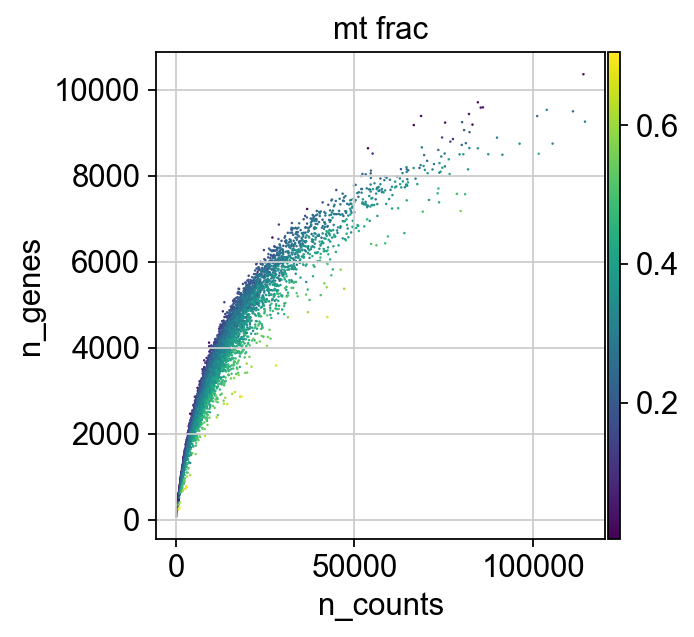

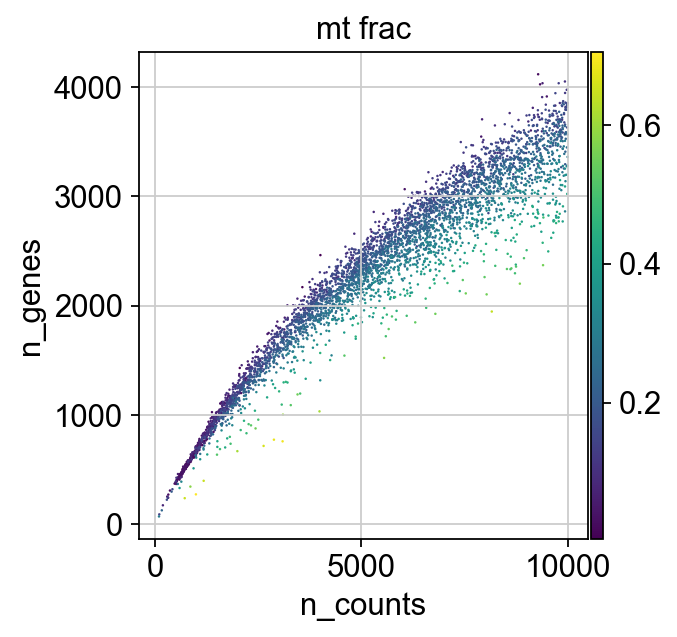

In [22]:
if bool_plot == True:
    p1 = sc.pl.scatter(adata_rna, 'n_counts', 'n_genes', color='mt_frac', size=5)
    p2 = sc.pl.scatter(adata_rna[adata_rna.obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac', size=5)

### Cell Filtering

In [23]:
# Filter cells according to identified QC thresholds:
print(
    'Total number of cells: %i' % 
    (np.sum(adata_rna.shape[0]),)
)

if bool_recomp:
    adata_rna_filtered = adata_rna[adata_rna.obs['n_genes'] >= 1000]

    print(
        'Number of cells after min count and gene count filter: %i' % 
        (np.sum(adata_rna_filtered.shape[0]),)
    )

    adata_rna_filtered = adata_rna_filtered[adata_rna_filtered.obs['mt_frac'] < 0.5]
    print(
        'Number of cells after MT filter: %i' % 
        (np.sum(adata_rna_filtered.shape[0]),)
    )
else:
    adata_rna_filtered = sc.read(dir_anndata+'adata_mulitome_rna_filtered.h5ad') 

Total number of cells: 7871
Number of cells after min count and gene count filter: 7388
Number of cells after MT filter: 7292


In [24]:
adata_atac_filtered = adata_atac[adata_rna_filtered.obs_names, :].copy()

In [25]:
adata_rna_filtered

View of AnnData object with n_obs × n_vars = 7292 × 22597
    obs: 'synAscl1', 'synAscl1_log', 'synMyod1', 'synMyod1_log', 'DsRed', 'DsRed_log', 'AcGFP1', 'AcGFP1_log', 'EBFP2', 'EBFP2_log', 'Ascl1', 'Ascl1_log', 'Myod1', 'Myod1_log', 'Ascl1_total', 'Ascl1_total_log', 'Myod1_total', 'Myod1_total_log', 'total_count_with_transgenes', 'total_count_without_transgenes', 'n_genes', 'n_counts', 'mt_frac'
    var: 'gene_ids', 'feature_types', 'genome'

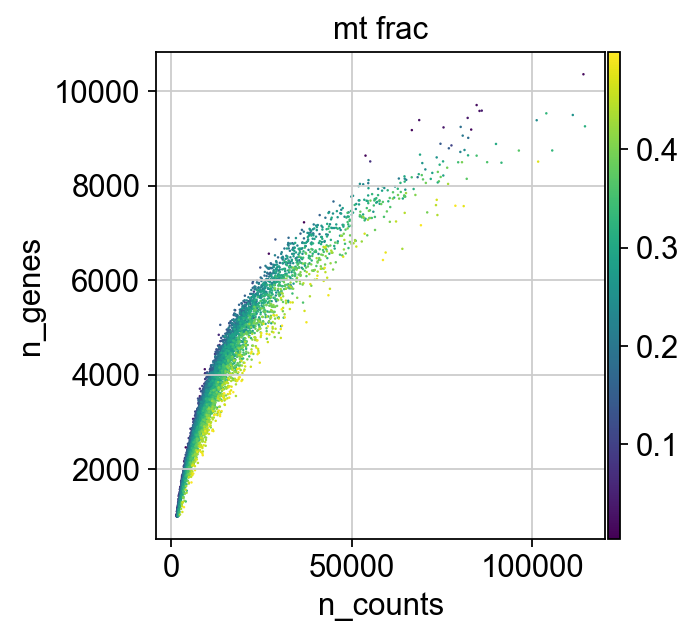

In [26]:
if bool_plot == True:
    sc.pl.scatter(adata_rna_filtered, 'n_counts','n_genes', color='mt_frac', size=5)

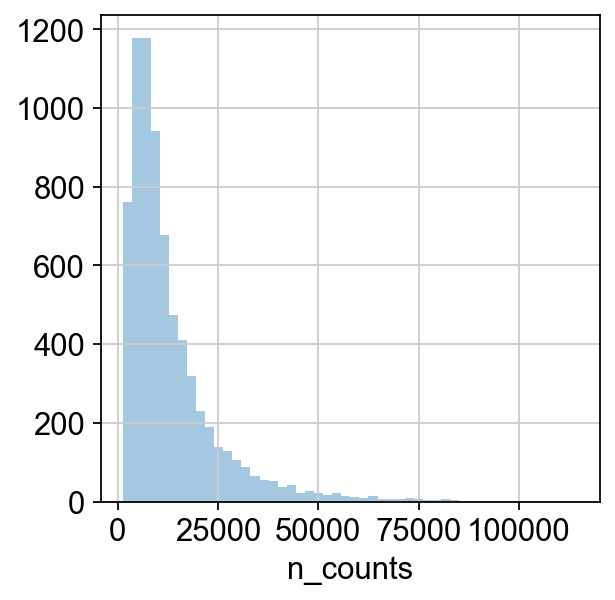

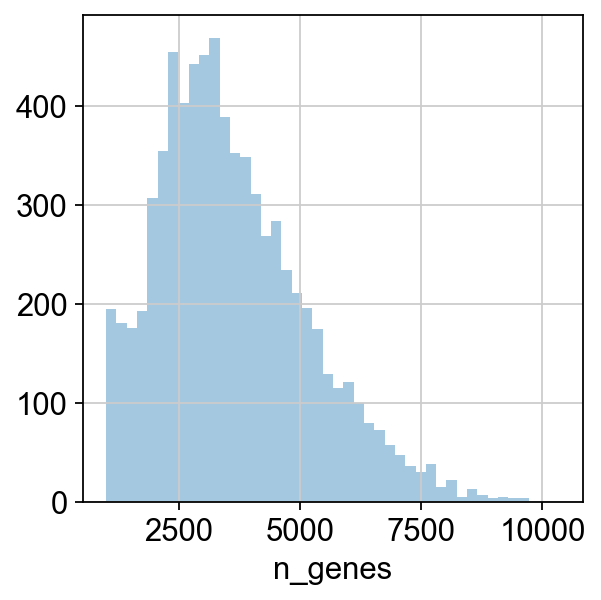

In [27]:
if bool_plot == True:
    ax = sb.distplot(adata_rna_filtered.obs['n_counts'], kde = False)
    plt.show()
    ax = sb.distplot(adata_rna_filtered.obs['n_genes'], kde = False)
    plt.show()

## Quality control: genes

### Gene filtering

In [28]:
adata_rna_filtered.var["n_counts"] = np.asarray(np.sum(adata_rna_filtered.X, axis=0)).flatten()
adata_rna_filtered.var["n_cells"] = np.asarray(np.sum(adata_rna_filtered.X > 0, axis=0)).flatten()

Trying to set attribute `.var` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


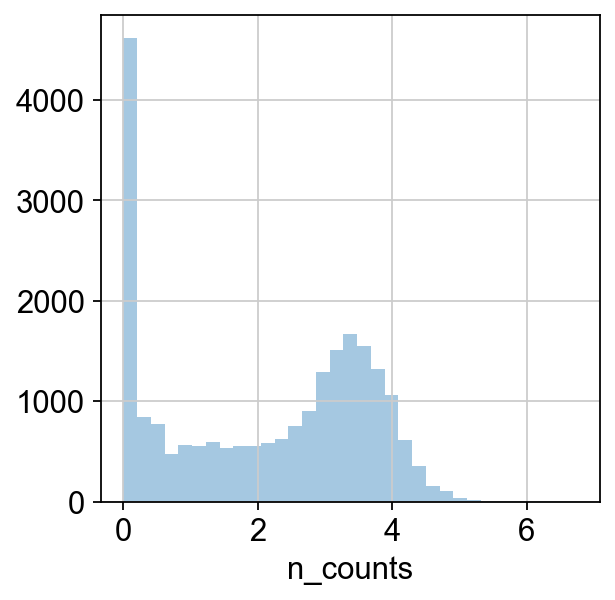

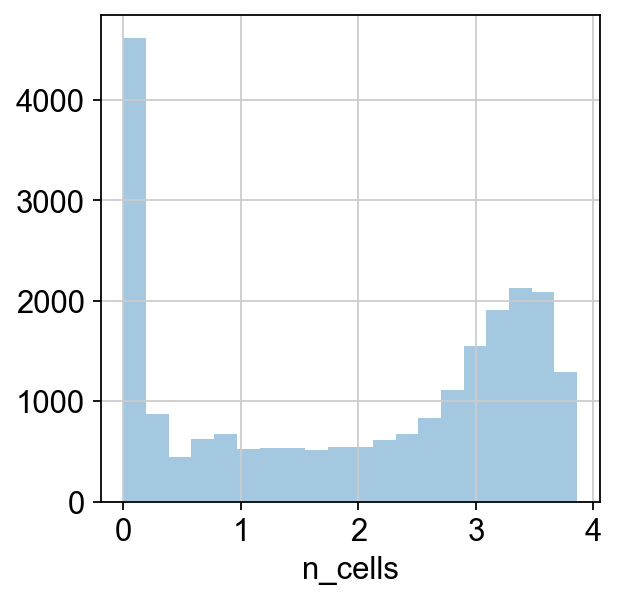

In [29]:
if bool_plot == True:
    ax = sb.distplot(np.log(adata_rna_filtered.var['n_counts']+1)/np.log(10), kde = False)
    plt.show()
    ax = sb.distplot(np.log(adata_rna_filtered.var['n_cells']+1)/np.log(10), kde = False)
    plt.show()

## Quality control: peaks

### Peak filtering

In [30]:
adata_atac_filtered.var["mean_nonzero_counts"] = np.asarray(np.sum(adata_atac_filtered.X, axis=0)).flatten() / \
    np.asarray(np.sum(adata_atac_filtered.X > 0, axis=0)).flatten()
adata_atac_filtered.var["n_counts"] = np.asarray(np.sum(adata_atac_filtered.X, axis=0)).flatten()
adata_atac_filtered.var["n_cells"] = np.asarray(np.sum(adata_atac_filtered.X > 0, axis=0)).flatten()

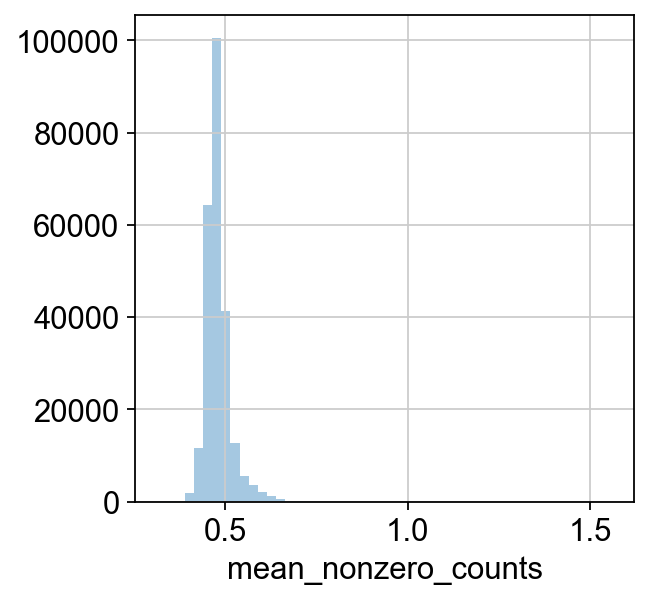

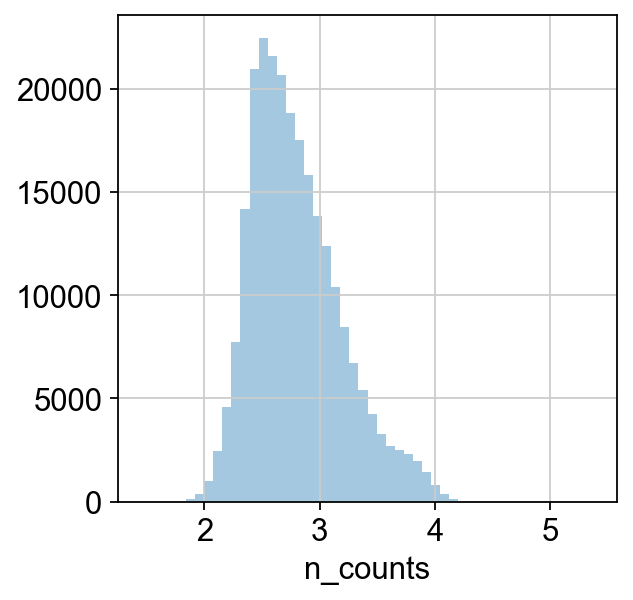

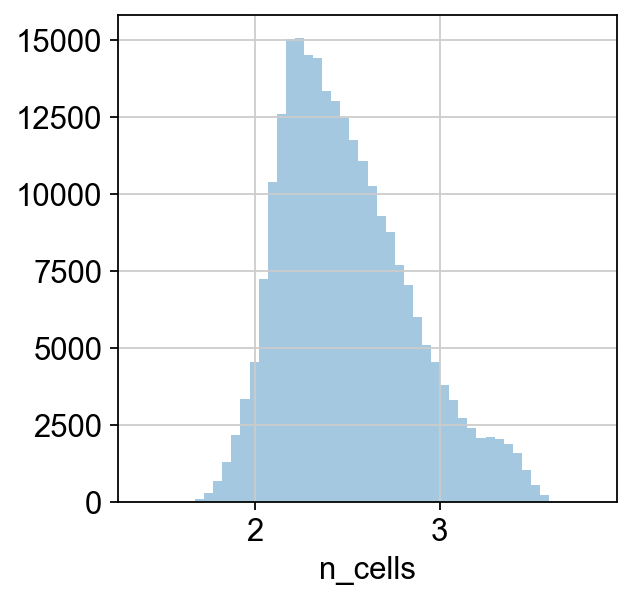

In [31]:
if bool_plot == True:
    ax = sb.distplot(np.log(adata_atac_filtered.var['mean_nonzero_counts']+1)/np.log(10), kde = False)
    plt.show()
    ax = sb.distplot(np.log(adata_atac_filtered.var['n_counts']+1)/np.log(10), kde = False)
    plt.show()
    ax = sb.distplot(np.log(adata_atac_filtered.var['n_cells']+1)/np.log(10), kde = False)
    plt.show()

## Add normalization into objects

### RNA

In [32]:
sf = adata_rna_filtered.obs["total_count_with_transgenes"]
sf = sf / np.mean(sf)
adata_rna_filtered.obs["sf"] = sf
for x in constructs + constructs_color + endogenous_genes + ["Ascl1_total", "Myod1_total"]:
    adata_rna_filtered.obs[x+"_norm_log"] = np.log(adata_rna_filtered.obs[x].values / sf + 1)

### ATAC

In [33]:
sf = adata_atac_filtered.obs["total_count"]
sf = sf / np.mean(sf)
adata_atac_filtered.obs["sf"] = sf

## Load ambient corrected data

In [34]:
# note: barcodes.tsv and features.tsv is from filtered data 
# features.tsv still contains peak feature names but matrix only contains gex
# we deleted all non gex rows from features.tsv to allow loading here
adata_soupx = sc.read_10x_mtx(fn_mtx_soupx, cache=False, gex_only=True)

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


In [35]:
adata_soupx_filtered = adata_soupx[adata_rna_filtered.obs_names, :]
adata_soupx_filtered.obs = adata_rna_filtered.obs
for x in constructs:
    adata_soupx_filtered.obs[x] = np.asarray(adata_soupx_filtered[:, x].X.todense()).flatten()
    adata_soupx_filtered.obs[x+"_log"] = np.log(np.asarray(adata_soupx_filtered[:, x].X.todense()).flatten() + 1.)
    adata_rna_filtered.obs[x+"_soupx"] = np.asarray(adata_soupx_filtered[:, x].X.todense()).flatten()
    adata_rna_filtered.obs[x+"_log_soupx"] = np.log(np.asarray(adata_soupx_filtered[:, x].X.todense()).flatten() + 1.)
for k, v in constructs_color_dict.items():
    adata_soupx_filtered.obs[k] = np.asarray(adata_soupx_filtered[:, v[0]].X.todense()).flatten() + np.asarray(adata_soupx_filtered[:, v[1]].X.todense()).flatten()
    adata_soupx_filtered.obs[k+"_log"] = np.log(adata_soupx_filtered.obs[k].values + 1.)
    adata_rna_filtered.obs[k+"_soupx"] = np.asarray(adata_soupx_filtered[:, v[0]].X.todense()).flatten() + np.asarray(adata_soupx_filtered[:, v[1]].X.todense()).flatten()
    adata_rna_filtered.obs[k+"_log_soupx"] = np.log(adata_soupx_filtered.obs[k].values + 1.)
for k, v in {
    "Ascl1_total": ['synAscl1', "Ascl1"],
    "Myod1_total": ['synMyod1', "Myod1"]
}.items():
    adata_soupx_filtered.obs[k] = np.sum(np.concatenate([
        np.expand_dims(np.asarray(adata_soupx_filtered[:, y].X.todense()).flatten(), axis=1)
        for y in v
    ], axis=1), axis=1)
    adata_soupx_filtered.obs[k+"_log"] = np.log(adata_soupx_filtered.obs[k].values + 1.)
    adata_rna_filtered.obs[k+"_soupx"] = adata_rna_filtered.obs[k].values
    adata_rna_filtered.obs[k+"_log_soupx"] = adata_rna_filtered.obs[k+"_log"].values

adata_soupx_filtered.obs["total_count_with_transgenes"] = np.asarray(np.sum(adata_soupx_filtered.X, axis=1)).flatten()
genes = list(adata_soupx_filtered.var_names) 
mask = np.ones(len(genes), dtype=bool)
for g in constructs:
    idx = genes.index(g)
    mask[idx] = False
for k, v in constructs_color_dict.items():
    idx = genes.index(v[0])
    mask[idx] = False
    idx = genes.index(v[1])
    mask[idx] = False
adata_soupx_filtered._inplace_subset_var(mask)
adata_soupx_filtered.obs["total_count_without_transgenes"] = np.asarray(np.sum(adata_soupx_filtered.X, axis=1)).flatten()

sf = adata_soupx_filtered.obs["total_count_with_transgenes"]
sf = sf / np.mean(sf)
adata_soupx_filtered.obs["sf_soupx"] = sf
for x in constructs + constructs_color:
    adata_soupx_filtered.obs[x+"_norm"] = adata_soupx_filtered.obs[x].values / sf
    adata_soupx_filtered.obs[x+"_norm_log"] = np.log(adata_soupx_filtered.obs[x].values / sf + 1)
    adata_rna_filtered.obs[x+"_norm_soupx"] = adata_soupx_filtered.obs[x].values / sf
    adata_rna_filtered.obs[x+"_norm_log_soupx"] = np.log(adata_soupx_filtered.obs[x].values / sf + 1)

In [36]:
for x in constructs + constructs_color:
    adata_soupx_filtered.obs[x+"_raw"] = adata_rna_filtered.obs[x+""].values
    adata_soupx_filtered.obs[x+"_log_raw"] = adata_rna_filtered.obs[x+"_log"].values
    adata_soupx_filtered.obs[x+"_norm_log_raw"] = adata_rna_filtered.obs[x+"_norm_log"].values

# Transgene abundance

## Raw abundance

### Filtered data

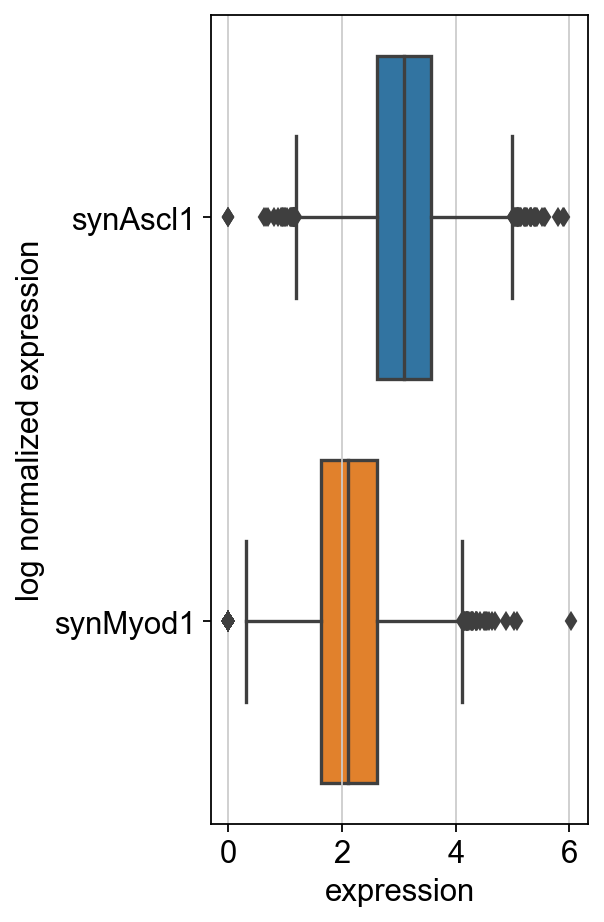

In [37]:
sns_data = pd.concat([
    pd.DataFrame({
        "gene": x.split("_")[0],
        "expression": adata_rna_filtered.obs[x + "_norm_log"].values,
    }) for x in constructs
])
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(4, 6))
sb.boxplot(
    data=sns_data,
    y="gene", x="expression",
    ax=axs
)
axs.xaxis.set_tick_params(rotation=0)
axs.set_ylabel("log normalized expression")
plt.tight_layout()
plt.show()

### After ambient correction

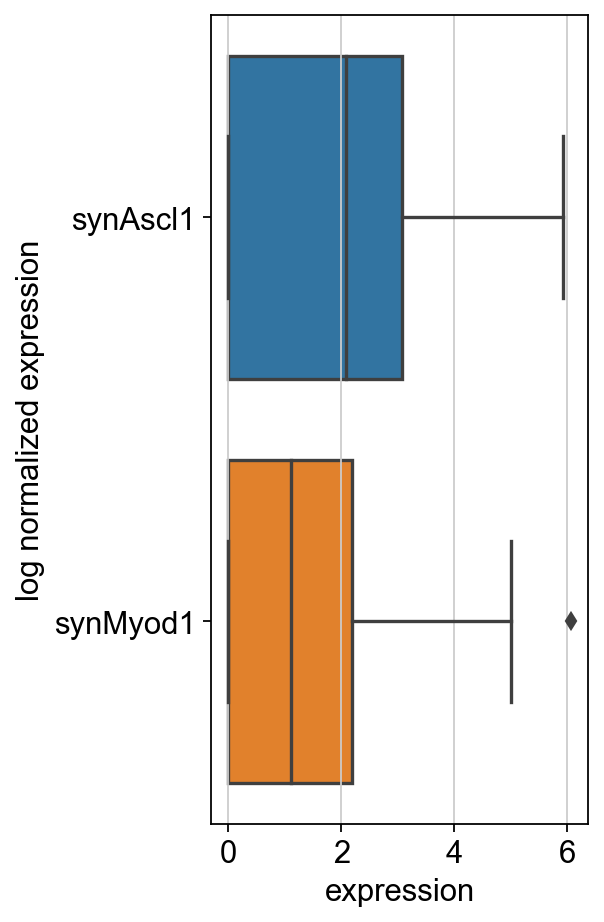

In [38]:
sns_data = pd.concat([
    pd.DataFrame({
        "gene": x.split("_")[0],
        "expression": adata_soupx_filtered.obs[x + "_norm_log"].values,
    }) for x in constructs
])
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(4, 6))
sb.boxplot(
    data=sns_data,
    y="gene", x="expression",
    ax=axs
)
axs.xaxis.set_tick_params(rotation=0)
axs.set_ylabel("log normalized expression")
plt.tight_layout()
plt.show()

## Endo- versus transgene

(['synAscl1', 'synMyod1'], ['Ascl1', 'Myod1'])


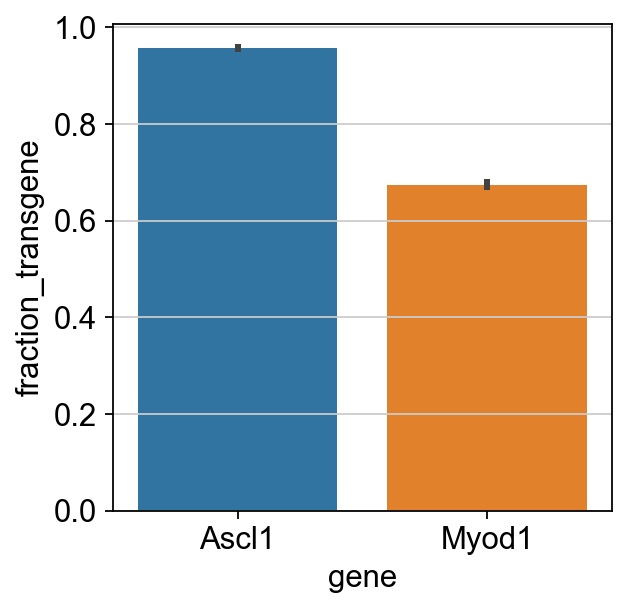

In [39]:
print((constructs, endogenous_genes))
sns_data = pd.concat([
    pd.DataFrame({
        "fraction_transgene": adata_rna_filtered.obs[x + "_norm_log"] / 
            (adata_rna_filtered.obs[x + "_norm_log"] + adata_rna_filtered.obs[y + "_norm_log"]),
        "gene": x.split("syn")[-1],
        "type": "transgene"
    })
    for x, y in zip(constructs, endogenous_genes)
])
sb.barplot(
    data=sns_data, 
    x="gene", y="fraction_transgene",
)
plt.show()

### After ambient correction

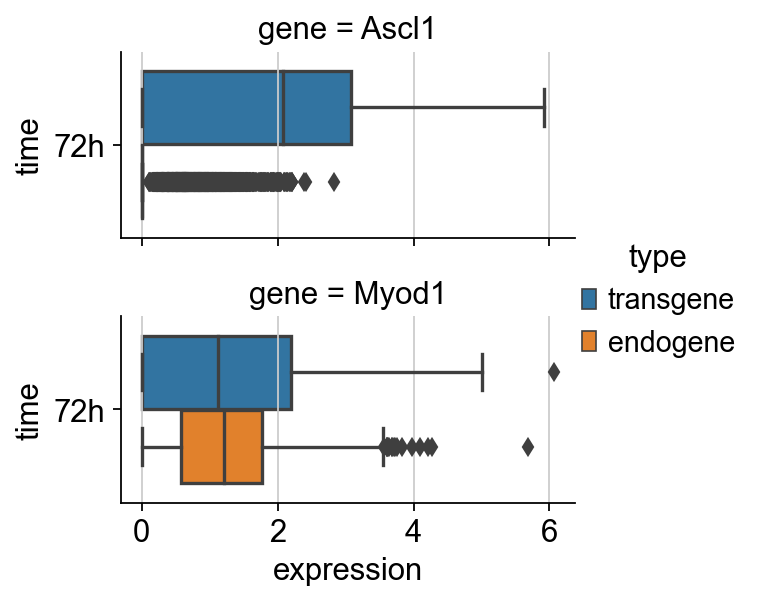

In [40]:
sns_data = pd.concat([
    pd.concat([
        pd.DataFrame({
            "time": "72h",
            "expression": adata_soupx_filtered.obs[x + "_norm_log"],
            "gene": x.split("syn")[-1],
            "type": "transgene"
        })
        for x in constructs
    ]),
    pd.concat([
        pd.DataFrame({
            "time": "72h",
            "expression": adata_soupx_filtered.obs[x + "_norm_log"],
            "gene": x.split("_")[0],
            "type": "endogene"
        })
        for x in endogenous_genes
    ])
])
sb.catplot(
    data=sns_data, 
    kind="box", dodge=True, row="gene",
    x="expression", y="time", hue="type",
    aspect=2, height=2
)
plt.show()

# Unsupervised overview of data set

In [41]:
downstream_genes = ['myog', 'des', 'mef2c', 'tnni1', 'mylpf']
print([x for x in downstream_genes if x not in adata_rna_filtered.var_names])

['myog', 'des', 'mef2c', 'tnni1', 'mylpf']


## UMAP and louvain clustering on RNA data

In [42]:
if bool_recomp == True:   
    adata_rna_proc = adata_rna_filtered.copy()
    # Filter mt genes
    adata_rna_proc = adata_rna_proc[:, [not x.startswith('mt-') for x in adata_rna_proc.var_names]].copy()
    adata_rna_proc.var_names_make_unique()
    adata_rna_proc.var_names = [x.lower() for x in adata_rna_proc.var_names]
    adata_rna_proc.raw = adata_rna_proc
    sc.pp.normalize_per_cell(adata_rna_proc)
    sc.pp.log1p(adata_rna_proc)
    sc.pp.filter_genes(adata_rna_proc, min_cells=100)
    sc.pp.highly_variable_genes(adata_rna_proc, flavor='cell_ranger', n_top_genes=4000)
    sc.pp.pca(adata_rna_proc, n_comps=50, random_state=0, use_highly_variable=True, svd_solver='arpack')
    sc.pp.neighbors(adata_rna_proc, n_neighbors=100, knn=True, method='umap', n_pcs=50, random_state=0)
    sc.tl.umap(adata_rna_proc)
    if bool_recluster == True:
        sc.tl.louvain(adata_rna_proc, resolution=2., flavor='vtraag', random_state=0)
        if bool_write_cluster_cache:
            pd.DataFrame(adata_rna_proc.obs).to_csv(path_or_buf =dir_anndata+"obs_adata_rna_proc.csv")
            with open(dir_anndata+"uns_adata_rna_proc.pickle", "wb") as f:
                pickle.dump(obj=adata_rna_proc.uns, file=f)
    else:
        obs = pd.read_csv(dir_anndata+'obs_adata_rna_proc.csv')
        adata_rna_proc.obs['louvain'] = pd.Series(obs['louvain'].values, dtype = 'category')
        adata_rna_proc.obs['louvain'] = [str(x) for x in obs['louvain'].values]
        adata_rna_proc.obs['louvain'] = pd.Series(adata_rna_proc.obs['louvain'], dtype='category')
        uns = pickle.load(open(dir_anndata + 'uns_adata_rna_proc.pickle', 'rb'))
        for k, v in uns.data.items():
            if k not in list(adata_rna_proc.uns.keys()):        
                adata_rna_proc.uns[k] = v
else:
    adata_rna_proc = sc.read(dir_anndata+'adata_rna_proc.h5ad') 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
filtered out 10056 genes that are detected in less than 100 cells
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:18)


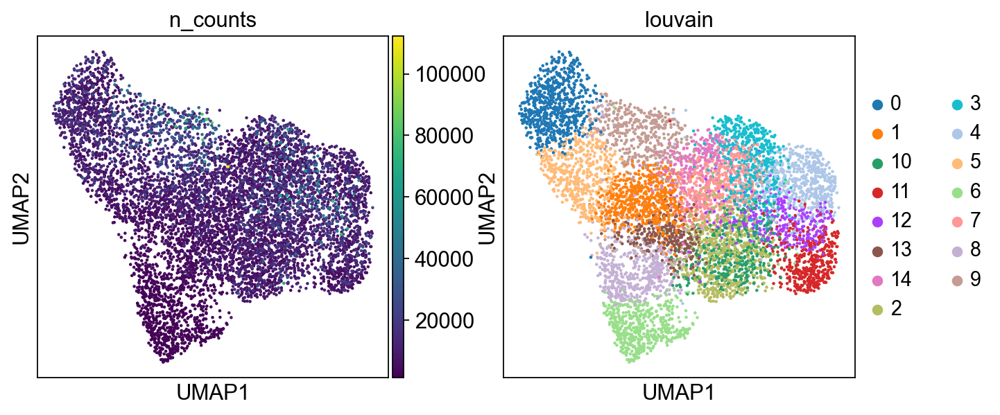

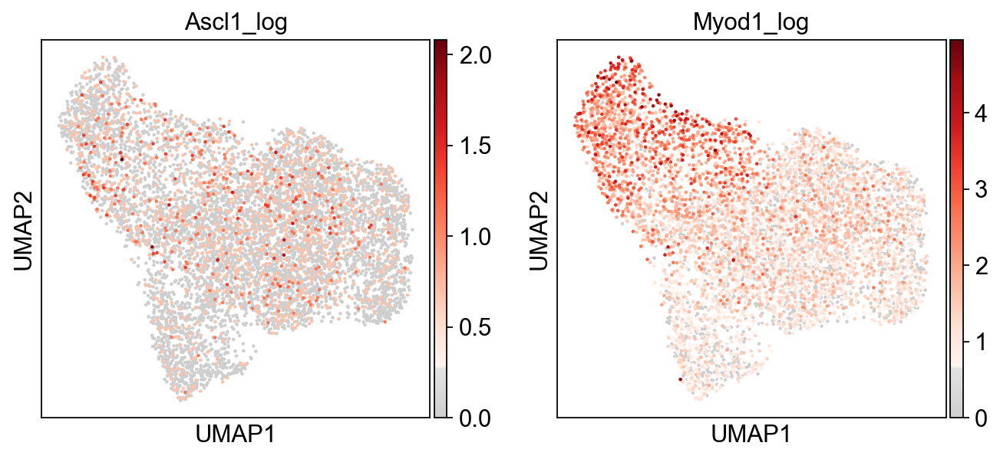

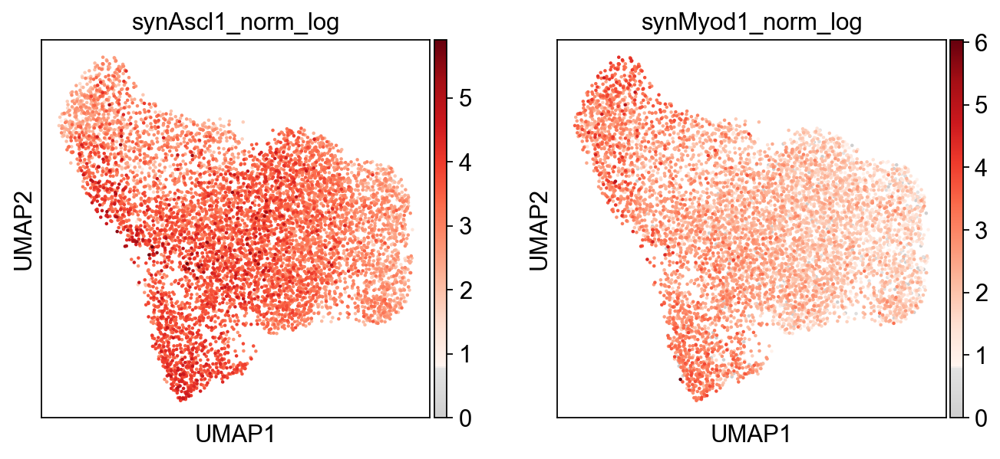

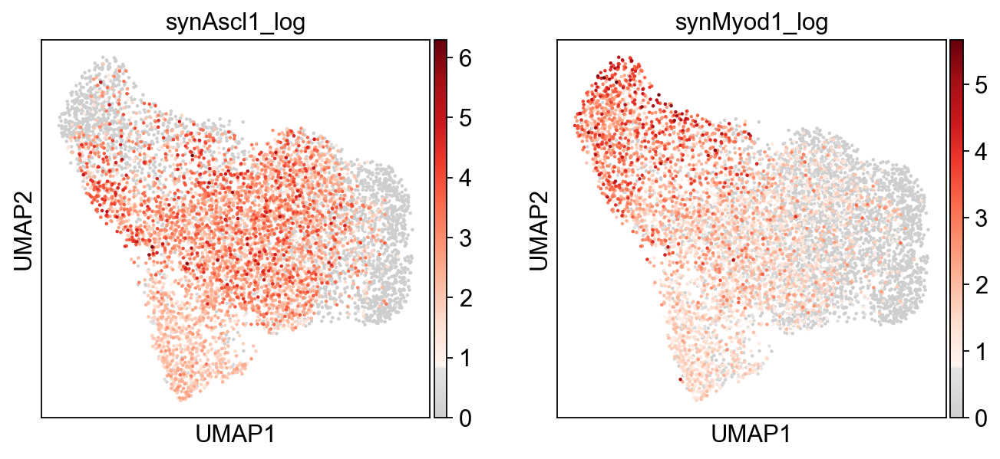

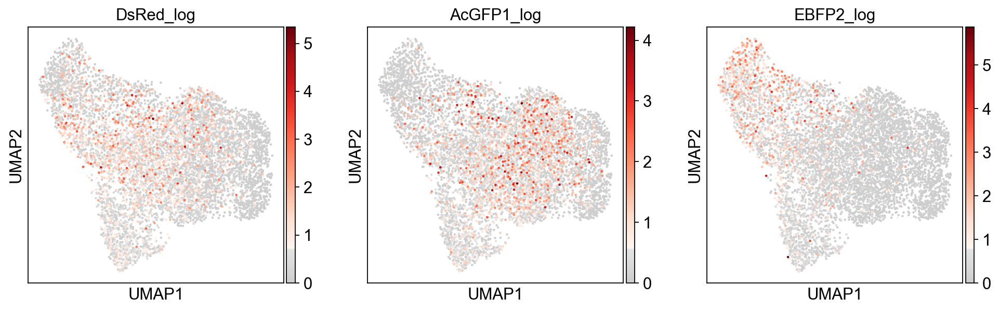

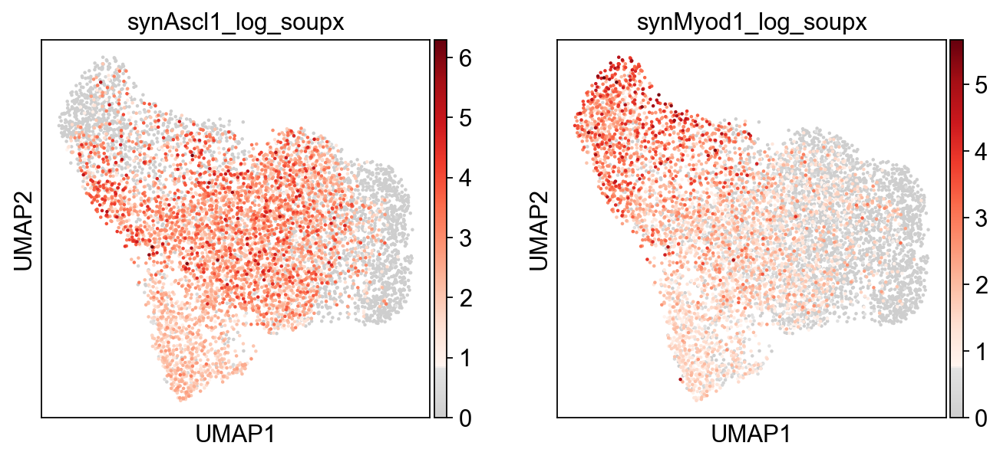

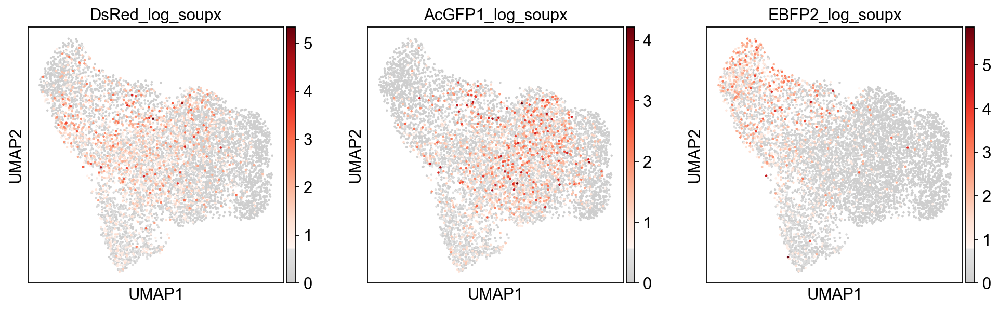

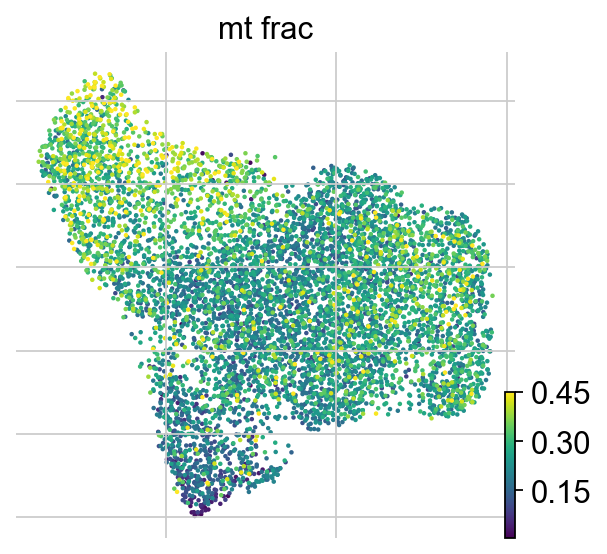

In [43]:
sc.pl.umap(adata_rna_proc, color=["n_counts", "louvain"])
sc.pl.umap(adata_rna_proc, color=[x+"_log" for x in endogenous_genes], cmap=mymap)
sc.pl.umap(adata_rna_proc, color=[x+"_norm_log" for x in constructs], cmap=mymap)
sc.pl.umap(adata_rna_proc, color=[x+"_log" for x in constructs], cmap=mymap)
sc.pl.umap(adata_rna_proc, color=[x+"_log" for x in constructs_color], cmap=mymap)
sc.pl.umap(adata_rna_proc, color=[x+"_log_soupx" for x in constructs], cmap=mymap)
sc.pl.umap(adata_rna_proc, color=[x+"_log_soupx" for x in constructs_color], cmap=mymap)
scv.pl.umap(adata_rna_proc, color=["mt_frac"], perc=[0,98])

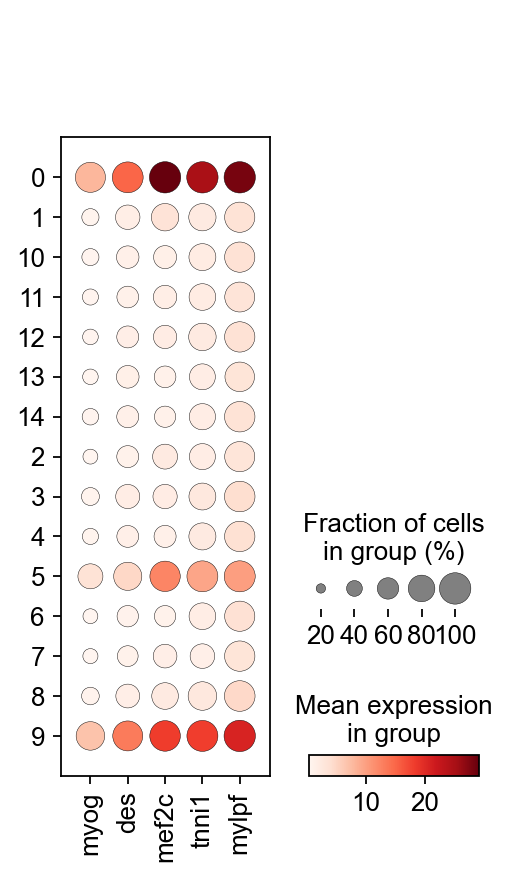

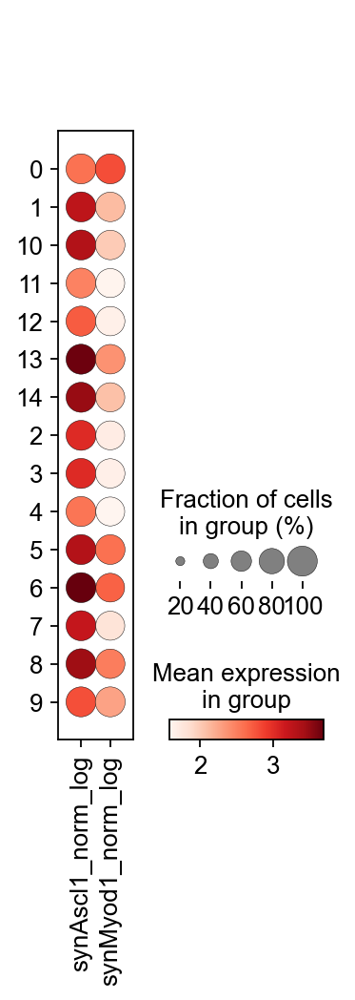

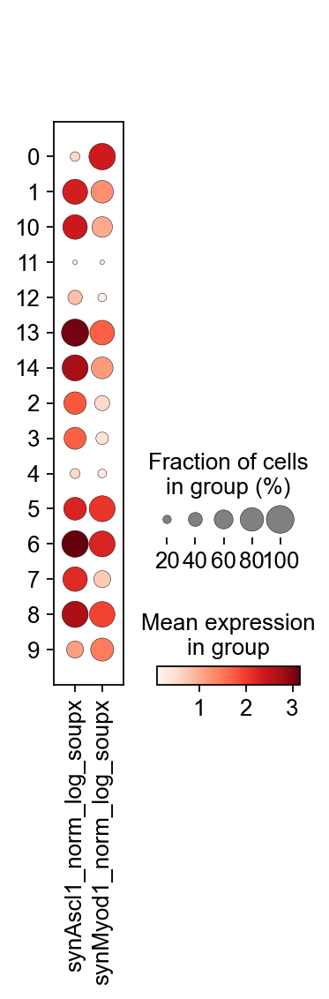

In [44]:
sc.pl.dotplot(
    adata_rna_proc, 
    var_names=downstream_genes,
    groupby="louvain")
sc.pl.dotplot(
    adata_rna_proc, 
    var_names=[x + "_norm_log" for x in constructs],
    groupby="louvain")
sc.pl.dotplot(
    adata_rna_proc, 
    var_names=[x + "_norm_log_soupx" for x in constructs],
    groupby="louvain")

## UMAP and louvain clustering on ambient corrected RNA data

In [45]:
if bool_recomp == True:   
    adata_soupx_proc = adata_soupx_filtered.copy()
    # Filter mt genes
    adata_soupx_proc = adata_soupx_proc[:, [not x.startswith('mt-') for x in adata_soupx_proc.var_names]].copy()
    adata_soupx_proc.var_names_make_unique()
    adata_soupx_proc.var_names = [x.lower() for x in adata_soupx_proc.var_names]
    adata_soupx_proc.raw = adata_rna_proc
    sc.pp.normalize_per_cell(adata_soupx_proc)
    sc.pp.log1p(adata_soupx_proc)
    sc.pp.filter_genes(adata_soupx_proc, min_cells=100)
    sc.pp.highly_variable_genes(adata_soupx_proc, flavor='cell_ranger', n_top_genes=4000)
    sc.pp.pca(adata_soupx_proc, n_comps=50, random_state=0, use_highly_variable=True, svd_solver='arpack')
    sc.pp.neighbors(adata_soupx_proc, n_neighbors=100, knn=True, method='umap', n_pcs=50, random_state=0)
    sc.tl.umap(adata_soupx_proc)
    if bool_recluster == True:
        sc.tl.louvain(adata_soupx_proc, resolution=2., flavor='vtraag', random_state=0)
        if bool_write_cluster_cache:
            pd.DataFrame(adata_soupx_proc.obs).to_csv(path_or_buf =dir_anndata+"obs_adata_soupx_proc.csv")
            with open(dir_anndata+"uns_adata_soupx_proc.pickle", "wb") as f:
                pickle.dump(obj=adata_soupx_proc.uns, file=f)
    else:
        obs = pd.read_csv(dir_anndata+'obs_adata_soupx_proc.csv')
        adata_soupx_proc.obs['louvain'] = pd.Series(obs['louvain'].values, dtype = 'category')
        adata_soupx_proc.obs['louvain'] = [str(x) for x in obs['louvain'].values]
        adata_soupx_proc.obs['louvain'] = pd.Series(adata_soupx_proc.obs['louvain'], dtype='category')
        uns = pickle.load(open(dir_anndata + 'uns_adata_soupx_proc.pickle', 'rb'))
        for k, v in uns.data.items():
            if k not in list(adata_soupx_proc.uns.keys()):        
                adata_soupx_proc.uns[k] = v
else:
    adata_soupx_proc = sc.read(dir_anndata+'adata_soupx_proc.h5ad') 

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)
filtered out 10114 genes that are detected in less than 100 cells
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:18)


... storing 'feature_types' as categorical


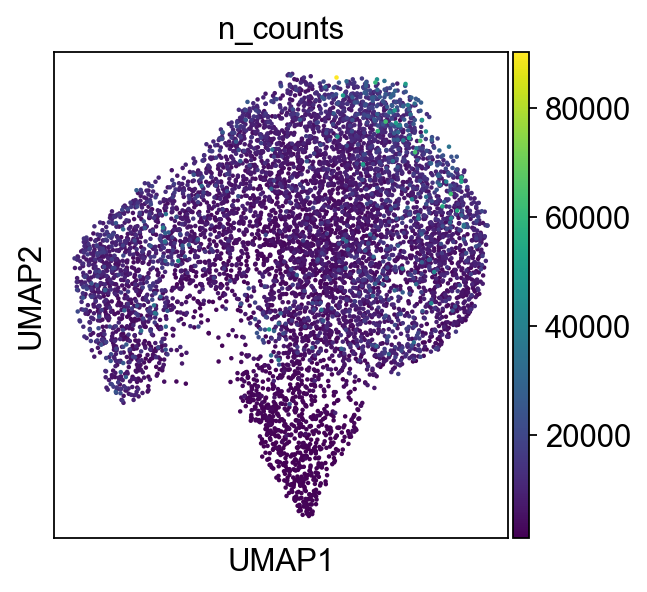

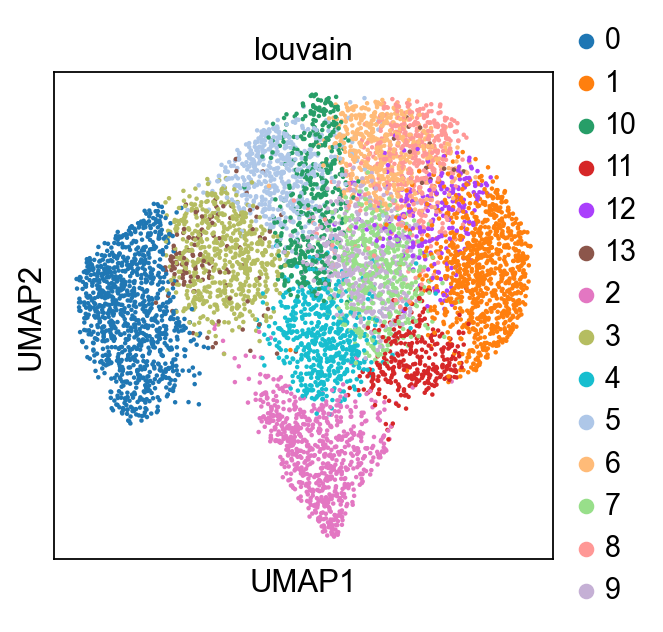

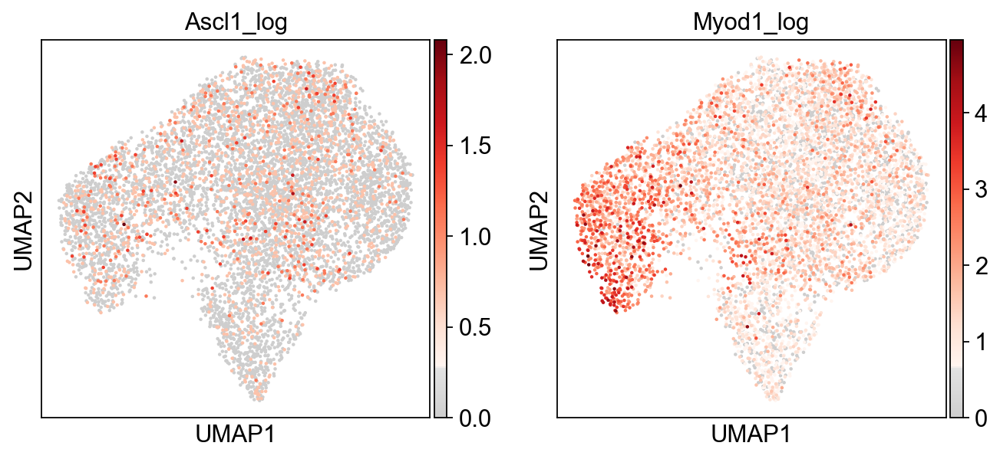

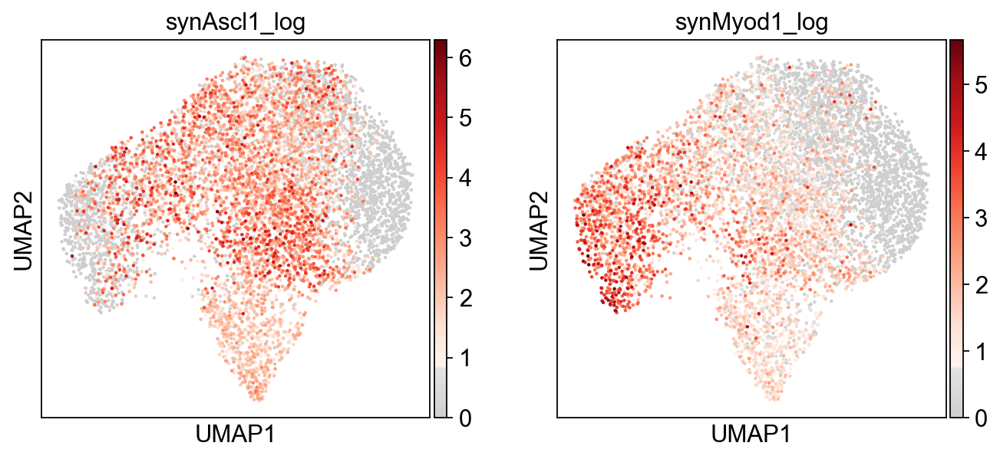

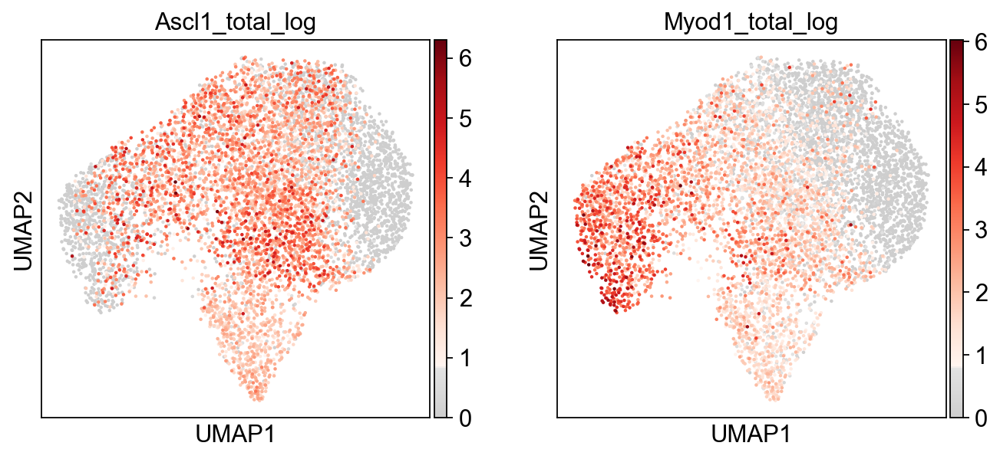

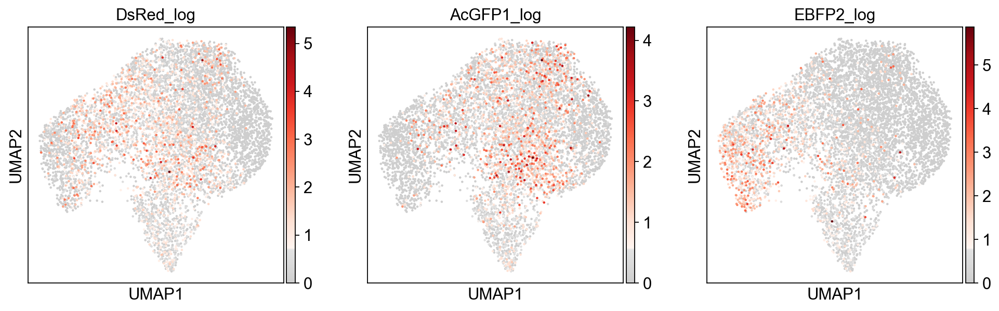

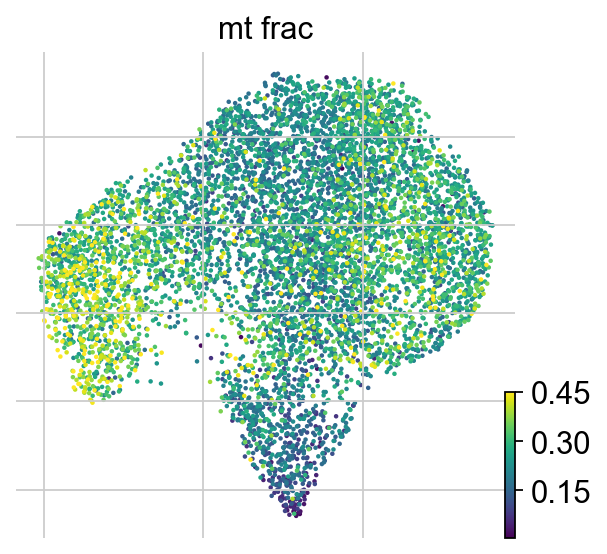

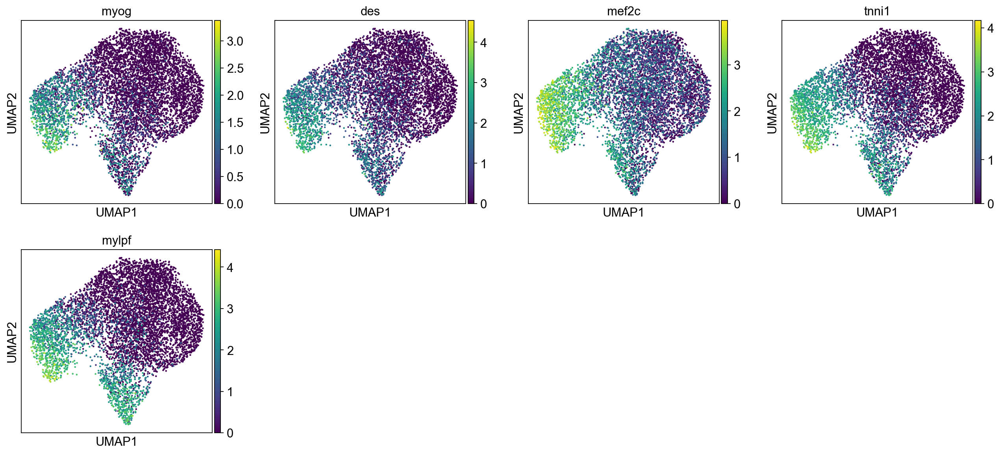

In [46]:
sc.pl.umap(adata_soupx_proc, color=["n_counts"])
sc.pl.umap(adata_soupx_proc, color=["louvain"])
sc.pl.umap(adata_soupx_proc, color=[x+"_log" for x in endogenous_genes], cmap=mymap)
sc.pl.umap(adata_soupx_proc, color=[x+"_log" for x in constructs], cmap=mymap, save="EV5b.pdf")
sc.pl.umap(adata_soupx_proc, color=[x+"_total_log" for x in endogenous_genes], cmap=mymap)
sc.pl.umap(adata_soupx_proc, color=[x+"_log" for x in constructs_color], cmap=mymap)
scv.pl.umap(adata_soupx_proc, color=["mt_frac"], perc=[0,98])
sc.pl.umap(adata_soupx_proc, color=downstream_genes, use_raw=False)

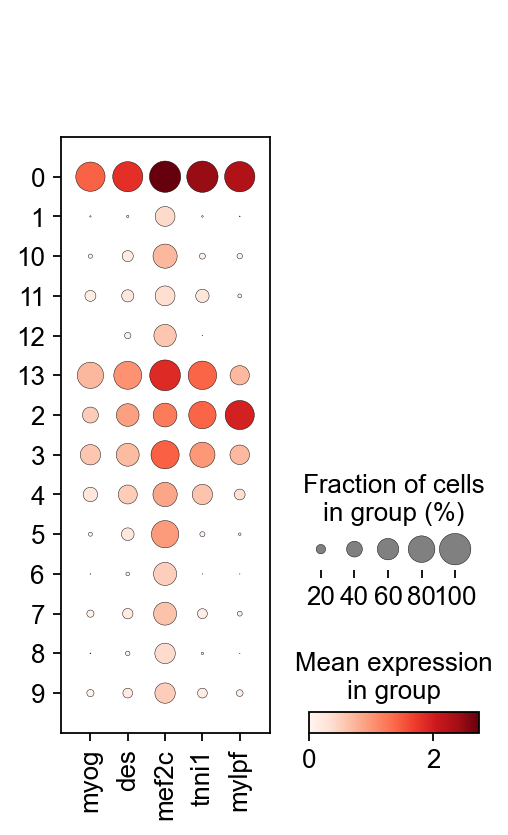

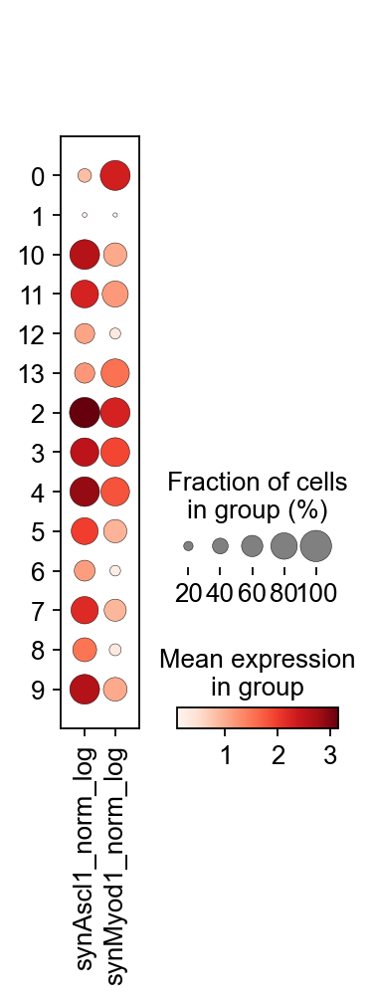

In [47]:
sc.pl.dotplot(
    adata_soupx_proc, 
    var_names=downstream_genes,
    groupby="louvain", 
    use_raw=False)
sc.pl.dotplot(
    adata_soupx_proc, 
    var_names=[x + "_norm_log" for x in constructs],
    groupby="louvain", 
    use_raw=False)

In [48]:
cluster_map = {
    "0": "myogenic_1",
    "13": "myogenic_2",
    "3": "myogenic_3",
    "2": "collision_1",
    "4": "collision_2",
    "5": "collision_3",
    "7": "collision_4",
    "9": "collision_5",
    "10": "collision_6",
    "11": "collision_7",
    "1": "control_1",
    "6": "control_2",
    "8": "control_3",
    "12": "control_4",
}
for x in ['louvain_named_colors', 'louvain_coarse_colors']:
    if x in adata_soupx_proc.uns.keys():
        del adata_soupx_proc.uns[x]
    if x.strip("_colors") in adata_soupx_proc.obs.columns:
        del adata_soupx_proc.obs[x]
adata_soupx_proc.obs["louvain_named"] = pd.Categorical([
    cluster_map[x] for x in adata_soupx_proc.obs["louvain"].values
], categories=list(cluster_map.values()))
adata_soupx_proc.obs["louvain_coarse"] = pd.Categorical([
    cluster_map[x].split("_")[0] for x in adata_soupx_proc.obs["louvain"].values
], categories=["myogenic", "collision", "control"])
id_cmap = {
    "myogenic_1": "#E69F00",
    "control_1": 'silver',
    "collision_1": 'forestgreen',
    "myogenic_3": "gold",
    "collision_2": "green",
    "collision_3": "lime",
    "control_2": '#444444',
    "collision_4": 'yellowgreen',
    "control_3": 'gainsboro',
    "collision_5": 'palegreen',
    "collision_6": 'chartreuse',
    "collision_7": 'springgreen',
    "control_4": "#555555",
    "myogenic_2": 'yellow',
}
id_cmap_coarse = {
    "myogenic": "#E69F00",
    "control": 'silver',
    "collision": 'forestgreen',
}

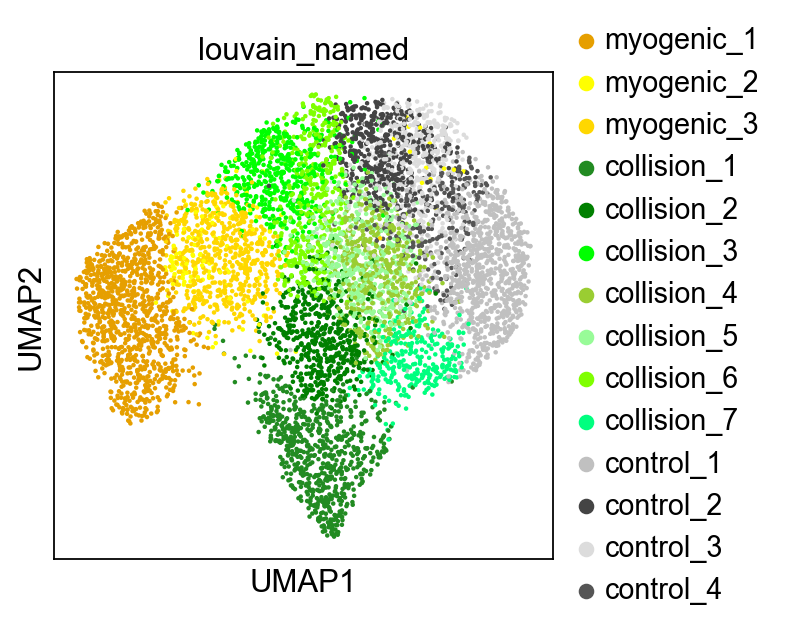

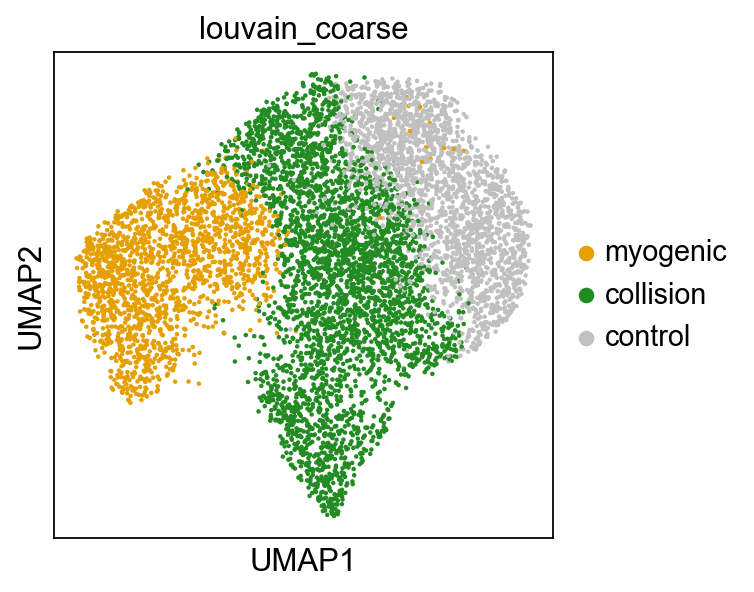

In [49]:
sc.pl.umap(
    adata_soupx_proc, 
    color="louvain_named",
    palette=[id_cmap[k] for k in cluster_map.values()],
)
sc.pl.umap(
    adata_soupx_proc, 
    color="louvain_coarse",
    palette=[id_cmap_coarse[k] for k in ["myogenic", "collision", "control"]], save="6b1.pdf"
)

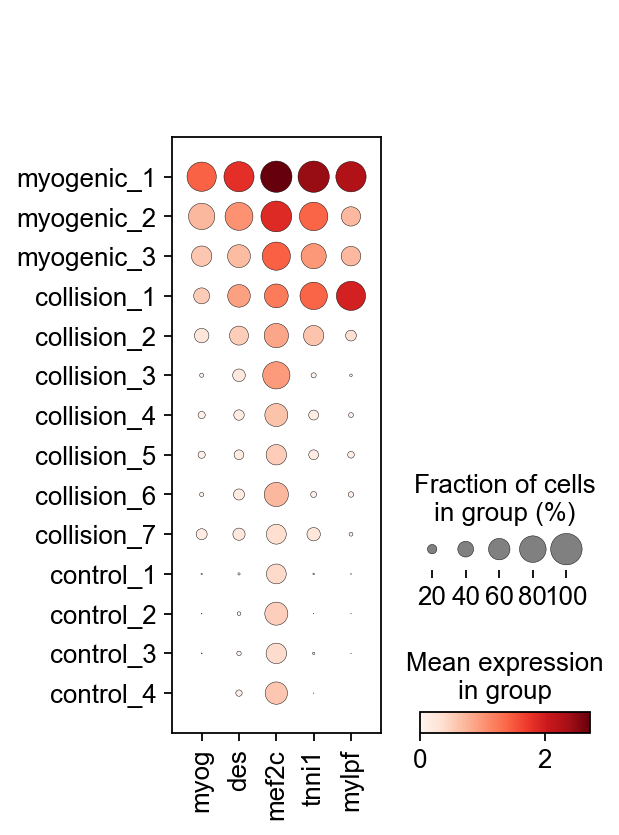

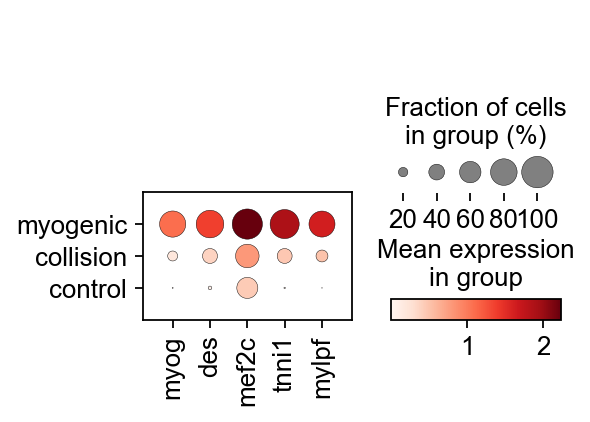

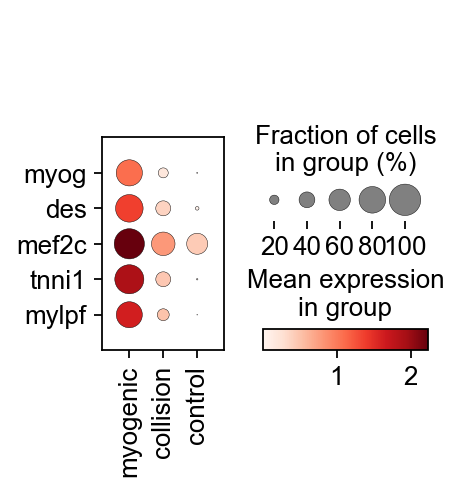

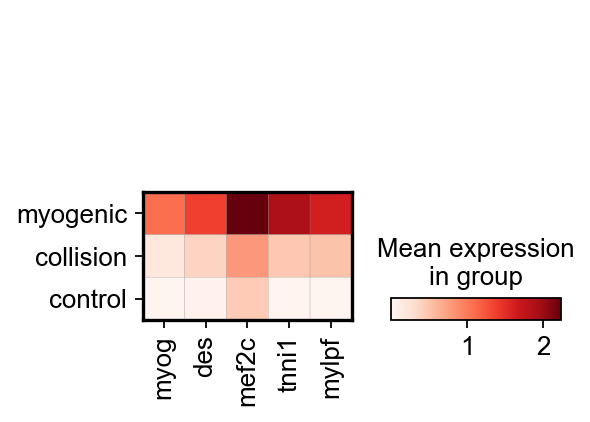

In [50]:
sc.pl.dotplot(
    adata_soupx_proc, 
    var_names=downstream_genes,
    groupby="louvain_named",
    use_raw=False)
sc.pl.dotplot(
    adata_soupx_proc, 
    var_names=downstream_genes,
    groupby="louvain_coarse", 
    use_raw=False)
sc.pl.dotplot(
    adata_soupx_proc, 
    var_names=downstream_genes,
    groupby="louvain_coarse", 
    swap_axes=True,
    use_raw=False)
sc.pl.matrixplot(
    adata_soupx_proc, 
    var_names=downstream_genes, cmap="Reds",
    groupby="louvain_coarse", 
    use_raw=False)

## UMAP and louvain clustering on ATAC data

In [51]:
if bool_recomp == True:   
    adata_atac_proc = adata_atac_filtered.copy()
    for k, v in adata_soupx_proc.obs.items():
        adata_atac_proc.obs[k] = v
    adata_atac_proc.obs["louvain_rna"] = adata_atac_proc.obs["louvain"].values
    adata_atac_proc.obs["louvain_named_rna"] = adata_atac_proc.obs["louvain_named"].values
    adata_atac_proc.obs["louvain_coarse_rna"] = adata_atac_proc.obs["louvain_coarse"].values
    adata_atac_proc.var_names = [x.lower() for x in adata_atac_proc.var_names]
    adata_atac_proc.raw = adata_atac_proc
    # Do not normalise as magnitude of chromatin accessibility is an important signal:
    #sc.pp.normalize_per_cell(adata_atac_proc)
    sc.pp.filter_genes(adata_atac_proc, min_cells=int(adata_atac_proc.n_obs*0.001))
    sc.pp.pca(adata_atac_proc, n_comps=50, random_state=0, svd_solver='arpack')
    sc.pp.neighbors(adata_atac_proc, n_neighbors=100, knn=True, method='umap', n_pcs=50, random_state=0)
    sc.tl.umap(adata_atac_proc)
    if bool_recluster == True:
        sc.tl.louvain(adata_atac_proc, resolution=2., flavor='vtraag', random_state=0)
        if bool_write_cluster_cache:
            pd.DataFrame(adata_atac_proc.obs).to_csv(path_or_buf =dir_anndata+"obs_adata_atac_proc.csv")
            with open(dir_anndata+"uns_adata_atac_proc.pickle", "wb") as f:
                pickle.dump(obj=adata_atac_proc.uns, file=f)
    else:
        obs = pd.read_csv(dir_anndata+'obs_adata_atac_proc.csv')
        adata_atac_proc.obs['louvain'] = pd.Series(obs['louvain'].values, dtype = 'category')
        adata_atac_proc.obs['louvain'] = [str(x) for x in obs['louvain'].values]
        adata_atac_proc.obs['louvain'] = pd.Series(adata_atac_proc.obs['louvain'], dtype='category')
        uns = pickle.load(open(dir_anndata + 'uns_adata_atac_proc.pickle', 'rb'))
        for k, v in uns.data.items():
            if k not in list(adata_atac_proc.uns.keys()):        
                adata_atac_proc.uns[k] = v
else:
    adata_atac_proc = sc.read(dir_anndata+'adata_atac_proc.h5ad') 

computing PCA
    with n_comps=50
    finished (0:03:09)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:18)


... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'gene' as categorical
... storing 'distance' as categorical
... storing 'peak_type' as categorical


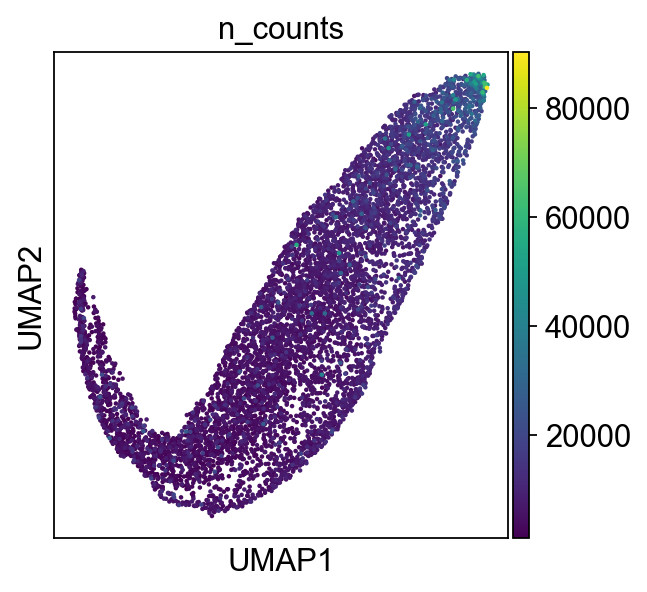

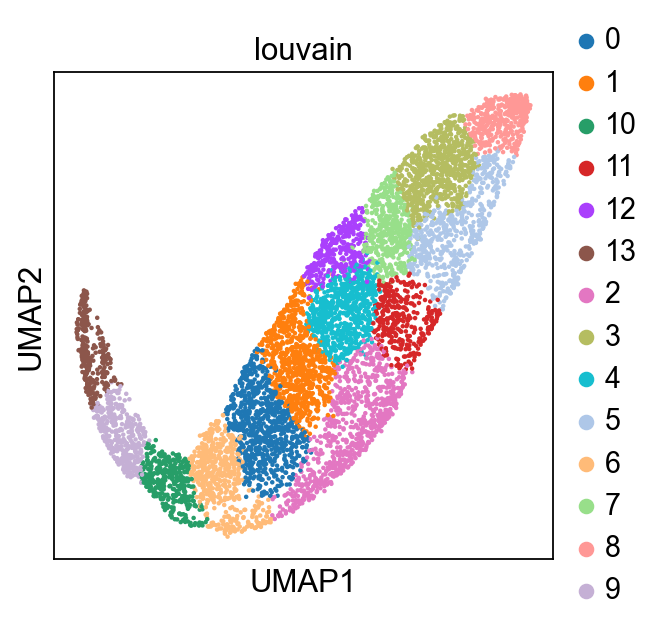

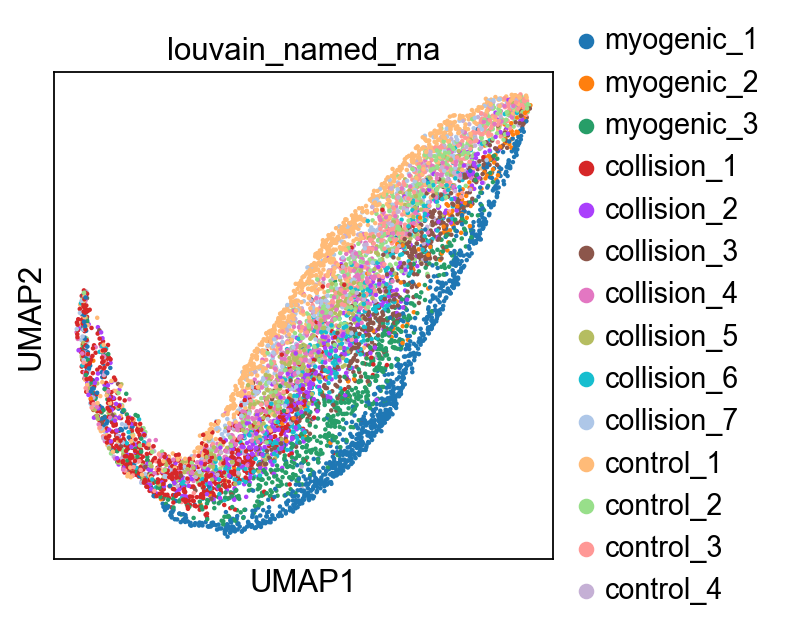

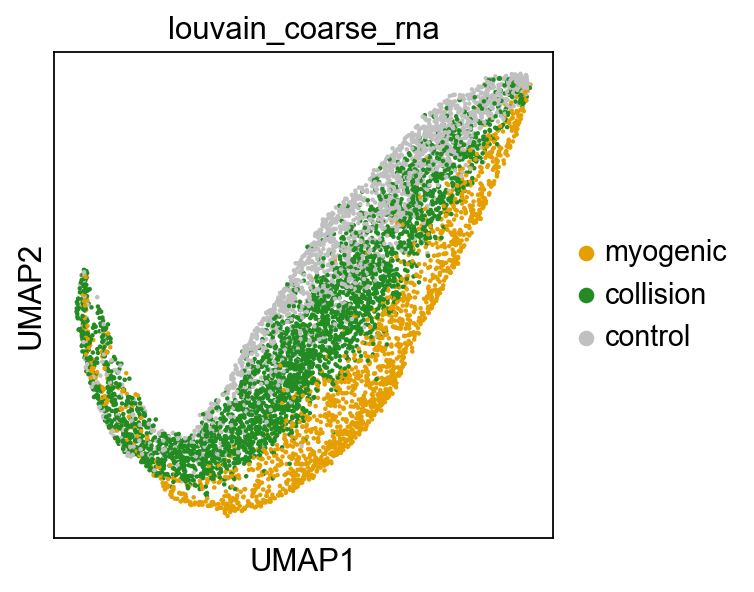

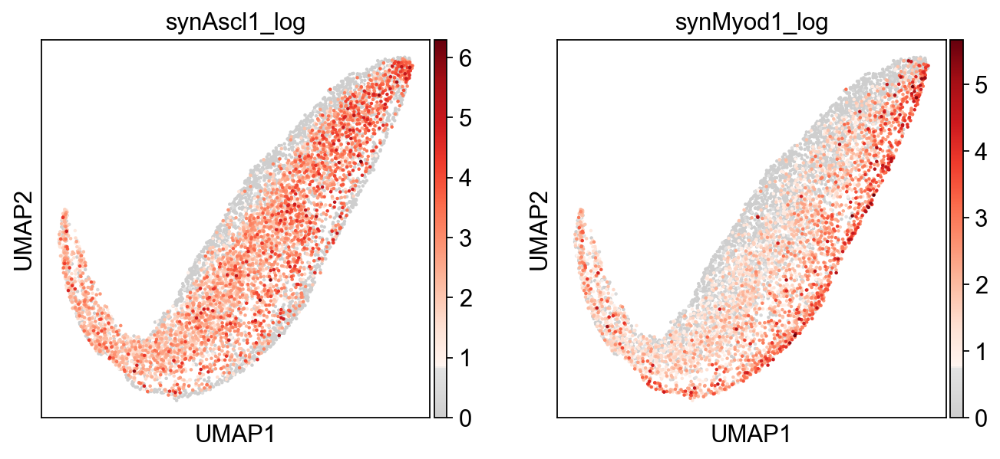

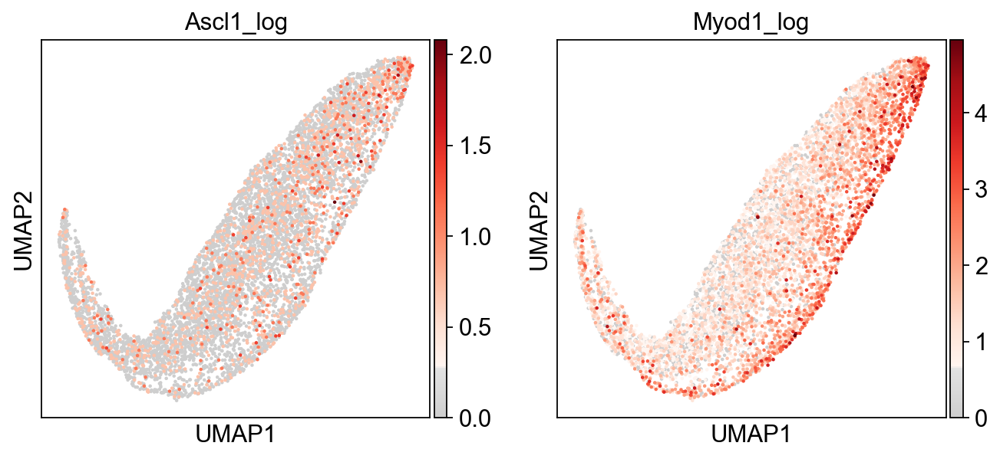

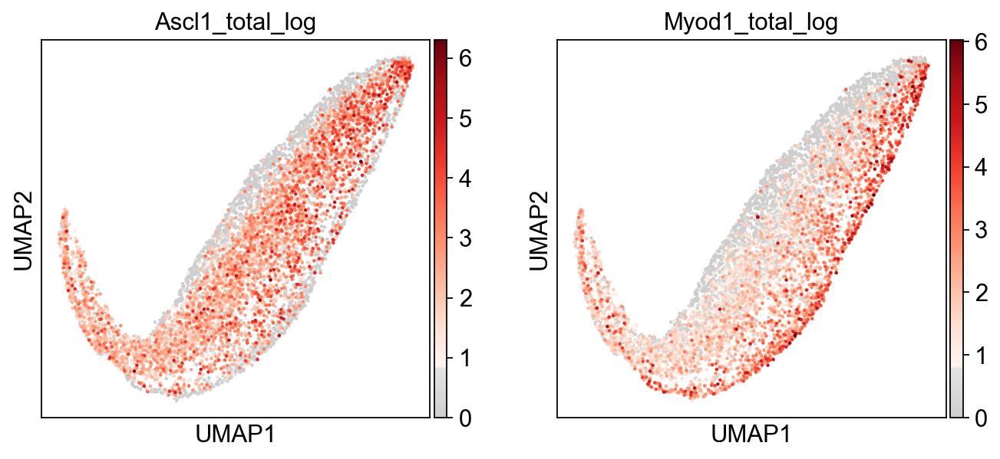

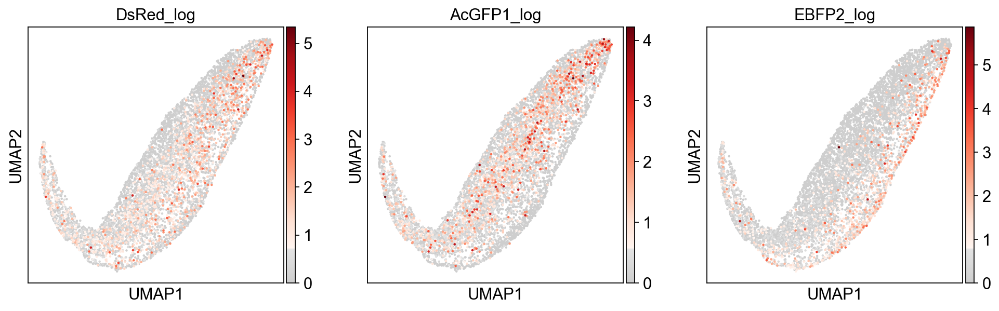

In [52]:
sc.pl.umap(adata_atac_proc, color=["n_counts"])
sc.pl.umap(adata_atac_proc, color=["louvain"])
sc.pl.umap(adata_atac_proc, color=["louvain_named_rna"])
sc.pl.umap(adata_atac_proc, color=["louvain_coarse_rna"], 
           palette=[id_cmap_coarse[k] for k in ["myogenic", "collision", "control"]], save="6b2.pdf")
sc.pl.umap(adata_atac_proc, color=[x+"_log" for x in constructs], cmap=mymap)

sc.pl.umap(adata_atac_proc, color=[x+"_log" for x in endogenous_genes], cmap=mymap)
sc.pl.umap(adata_atac_proc, color=[x+"_total_log" for x in endogenous_genes], cmap=mymap)
sc.pl.umap(adata_atac_proc, color=[x+"_log" for x in constructs_color], cmap=mymap)

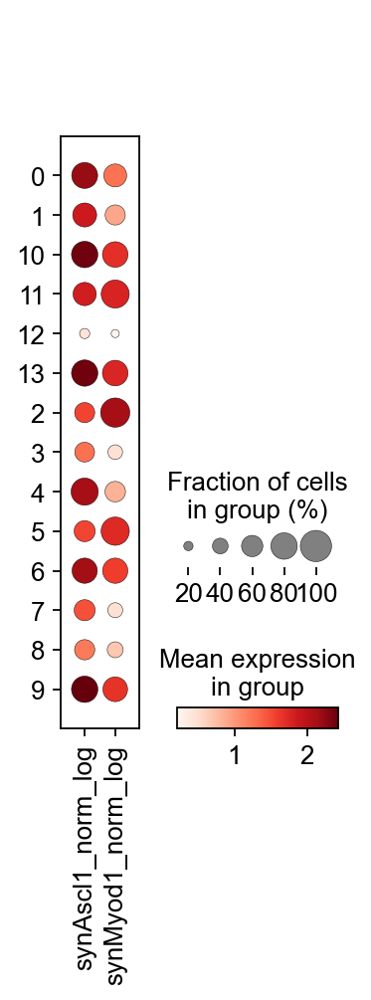

In [53]:
sc.pl.dotplot(
    adata_atac_proc, 
    var_names=[x + "_norm_log" for x in constructs],
    groupby="louvain")

## UMAP and louvain clustering on RNA+ATAC data

In [54]:
if bool_recomp == True:
    # Compute kNN graph concatenated PC space:
    pcs = adata_rna_proc.obsm["X_pca"].shape[1] + adata_atac_proc.obsm["X_pca"].shape[1]
    adata_rnaatac_proc = anndata.AnnData(
        np.concatenate([adata_rna_proc.obsm["X_pca"], adata_atac_proc.obsm["X_pca"]], axis=1),
        obs=adata_rna_filtered.obs,
        uns=adata_rna_filtered.uns,
    )
    adata_rnaatac_proc.obsm["X_pca"] = np.concatenate([adata_rna_proc.obsm["X_pca"], 
                                                       adata_atac_proc.obsm["X_pca"]], axis=1)
    sc.pp.neighbors(adata_rnaatac_proc, n_neighbors=100, knn=True, method='umap', n_pcs=pcs, random_state=0)
    sc.tl.umap(adata_rnaatac_proc, n_components=pcs)
    if bool_recluster == True:
        sc.tl.louvain(adata_rnaatac_proc, resolution=2., flavor='vtraag', random_state=0)
        if bool_write_cluster_cache:
            pd.DataFrame(adata_rnaatac_proc.obs).to_csv(path_or_buf=dir_anndata+"obs_adata_rnaatac_proc.csv")
            with open(dir_anndata+"uns_adata_rnaatac_proc.pickle", "wb") as f:
                pickle.dump(obj=adata_rnaatac_proc.uns, file=f)
    else:
        obs = pd.read_csv(dir_anndata+'obs_adata_rnaatac_proc.csv')
        adata_rnaatac_proc.obs['louvain'] = pd.Series(obs['louvain'].values, dtype = 'category')
        adata_rnaatac_proc.obs['louvain'] = [str(x) for x in obs['louvain'].values]
        adata_rnaatac_proc.obs['louvain'] = pd.Series(adata_atac_proc.obs['louvain'], dtype='category')
        uns = pickle.load(open(dir_anndata + 'uns_adata_rnaatac_proc.pickle', 'rb'))
        for k, v in uns.data.items():
            if k not in list(adata_rnaatac_proc.uns.keys()):        
                adata_rnaatac_proc.uns[k] = v
else:
    adata_rnaatac_proc = sc.read(dir_anndata+'adata_rnaatac_proc.h5ad') 

computing neighbors
    using 'X_pca' with n_pcs = 100
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:30)


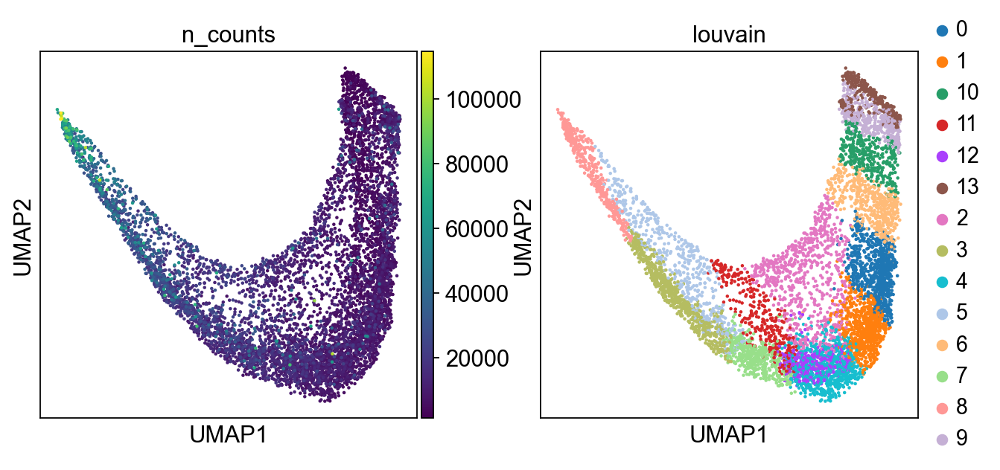

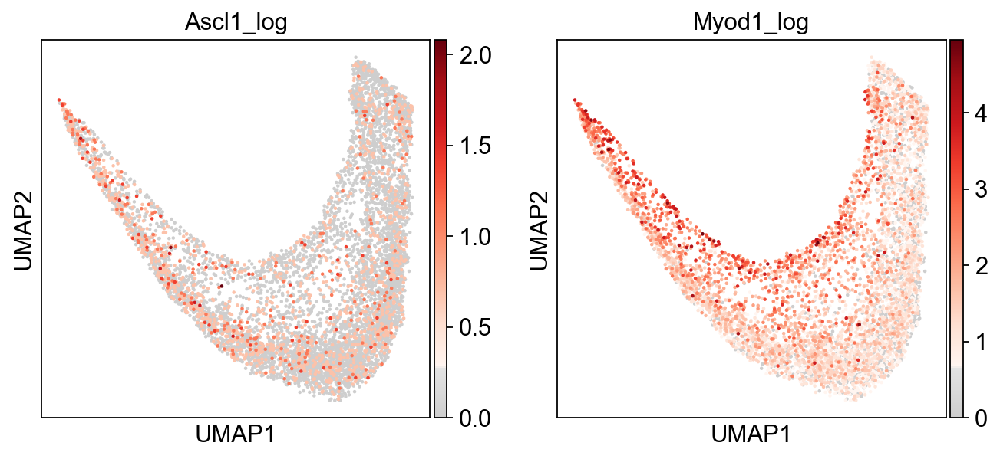

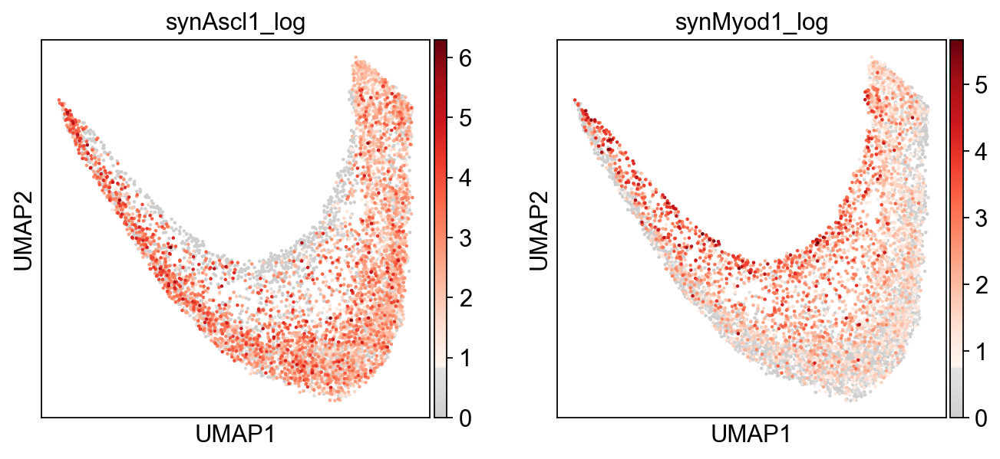

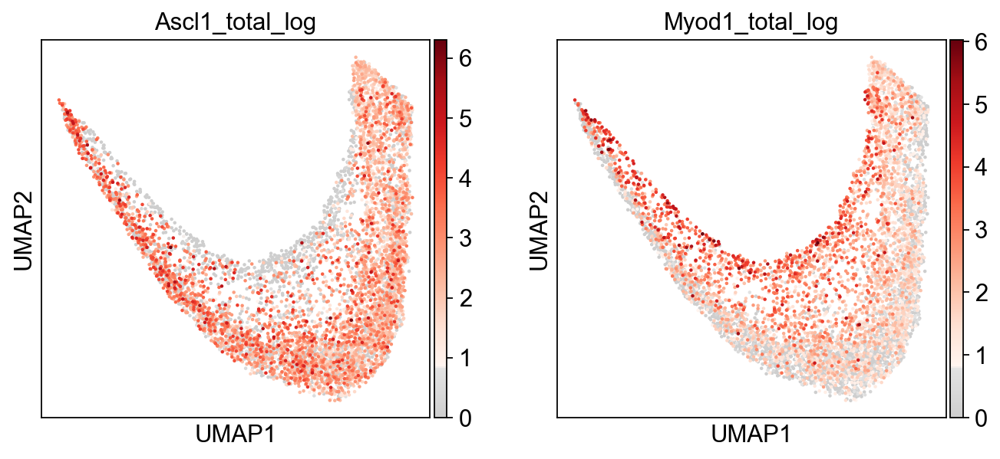

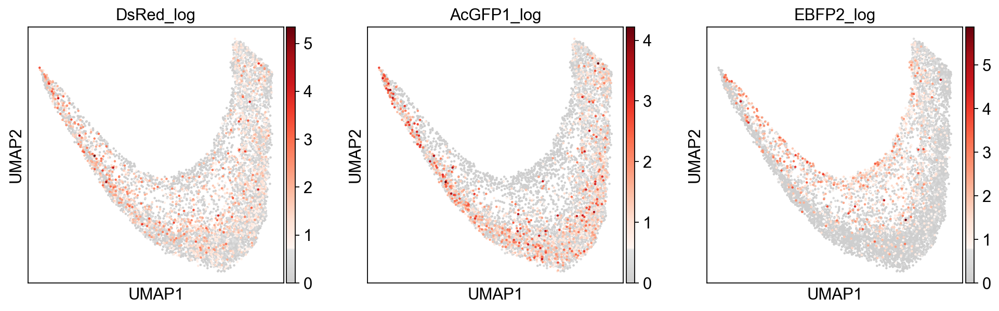

In [55]:
sc.pl.umap(adata_rnaatac_proc, color=["n_counts", "louvain"])
sc.pl.umap(adata_rnaatac_proc, color=[x+"_log" for x in endogenous_genes], cmap=mymap)
sc.pl.umap(adata_rnaatac_proc, color=[x+"_log" for x in constructs], cmap=mymap)
sc.pl.umap(adata_rnaatac_proc, color=[x+"_total_log" for x in endogenous_genes], cmap=mymap)
sc.pl.umap(adata_rnaatac_proc, color=[x+"_log" for x in constructs_color], cmap=mymap)

# Demultiplexing experimental batches

Note that in contrast to multiome sample 1, we do not use separate synAscl1mutant alignment here as the conditions are idenitifed by unique color combinations.

In [56]:
constructs_ordered_optim = [
    'AcGFP1', 
    'DsRed',
    'EBFP2', 
    'synAscl1',
    'synMyod1',
    #'Ascl1_total',
    #'Myod1_total',
]

We create a list containg the lists of all possible combinations of True/False for all of our 5 constructs (so 2^5 combinations). First 6 combinations are the ones that should actually occur and the remaining ones are the ones that should be zero:

In [57]:
#creating the occuring combinations
bool_combs_real = []
bool_combs_real.append([True , False, False, True , False])  # synmutantAscl1
bool_combs_real.append([False, True , False, True , False])  # synAscl1
bool_combs_real.append([False, False, True , False, True ])  # synMyod1
bool_combs_real.append([True , True , False, True , True ])  # synmutantAscl1+synMyod1
bool_combs_real.append([False, True , True , True , True ])  # synAscl1+synMyod1, 
bool_combs_real.append([True , True , True , False, False])  # empty control

for x in bool_combs_real:
    print("including condition: " + str(np.asarray(constructs_ordered_optim)[x]))
#creating all possible combinations
import itertools 
l=[False,True]
all_combs = [list(x) for x in list(itertools.product(l,repeat=5))]

all_combs = bool_combs_real + all_combs

#removing the duplicates while keeping the order (first are the occuring ones)
bool_combs = []
for comb in all_combs:
    if comb not in bool_combs:
        bool_combs.append(comb)

including condition: ['AcGFP1' 'synAscl1']
including condition: ['DsRed' 'synAscl1']
including condition: ['EBFP2' 'synMyod1']
including condition: ['AcGFP1' 'DsRed' 'synAscl1' 'synMyod1']
including condition: ['DsRed' 'EBFP2' 'synAscl1' 'synMyod1']
including condition: ['AcGFP1' 'DsRed' 'EBFP2']


## Thresholds from fraction-based optimization

In [58]:
use_soupx = False

In [59]:
processing = "_log"

In [60]:
suffix = "_soupx" if use_soupx else ""

In [61]:
print(f"did not find transgenes for {np.sum(adata_rna_proc.obs[constructs_ordered_optim].sum(axis=1) == 0)} cells")

did not find transgenes for 1033 cells


In [62]:
exclude_empty = True

In [63]:
if exclude_empty:
    adata_rna_proc_assignment = adata_rna_proc[adata_rna_proc.obs[constructs_ordered_optim].sum(axis=1).values > 0, :].copy()
else:
    adata_rna_proc_assignment = adata_rna_proc.copy()

### Gaussian mixture model

In [64]:
from sklearn.mixture import GaussianMixture

models = []
for i, construct in enumerate(constructs_ordered_optim):
    adata_rna_proc_assignment.obs[construct + '_positive_gmm'] = False
for i, construct in enumerate(constructs_ordered_optim):
    X = adata_rna_proc_assignment.obs[construct + processing + suffix].values.reshape(-1,1)

    models.append(GaussianMixture(n_components = 2, random_state = 0).fit(X))
    #here we assign the positive labels to the data points corresponding to the high count mixture
    labels = models[i].predict(X)
    high_count_mixture = np.argmax(models[i].means_)
    assignments = np.asarray(adata_rna_proc_assignment.obs[construct + '_positive_gmm'].values)
    assignments = (labels == high_count_mixture)
    adata_rna_proc_assignment.obs[construct + '_positive_gmm'] = assignments

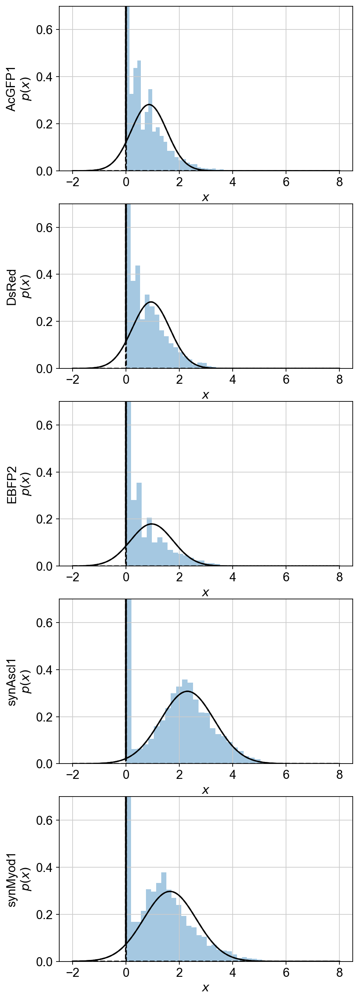

In [65]:
import scipy.stats as stats

fig, axs = plt.subplots(ncols=1, nrows=5, figsize=(6, 20))
for j, construct in enumerate(constructs_ordered_optim):
    X = adata_rna_proc_assignment.obs[construct + processing + suffix].values.reshape(-1,1)
    model = models[j]

    x = np.linspace(-2, 8, 1000)
    logprob = model.score_samples(x.reshape(-1, 1)) #compute the log probabilities for each sample.
    pdf = np.exp(logprob) #computes y values for the pdf

    axs[j].plot(x, model.weights_[0]*stats.norm.pdf(x, model.means_[0], np.sqrt(model.covariances_[0])).reshape(-1), '--k')
    axs[j].plot(x, model.weights_[1]*stats.norm.pdf(x, model.means_[1], np.sqrt(model.covariances_[1])).reshape(-1), '--k')

    axs[j].hist(X, 30, density=True, histtype='stepfilled', alpha=0.4)
    axs[j].plot(x, pdf, '-k')
    axs[j].set_ylabel('%s\n$p(x)$' % construct)
    axs[j].set_xlabel('$x$')
    axs[j].set_ylim(0, 0.7)

In [66]:
man_thresholds = {
    'AcGFP1': None, 
    'DsRed': None, 
    'EBFP2': None, 
    'synAscl1': None, 
    'synMyod1': None, 
}
for i, construct in enumerate(constructs+constructs_color):
    if man_thresholds[construct] is not None:
        adata_rna_proc_assignment.obs.loc[
            adata_rna_proc_assignment.obs[construct + processing + suffix].values >= man_thresholds[construct]
        , construct + '_positive_gmm'] = True
        adata_rna_proc_assignment.obs.loc[
            adata_rna_proc_assignment.obs[construct + processing + suffix].values < man_thresholds[construct]
        , construct + '_positive_gmm'] = False

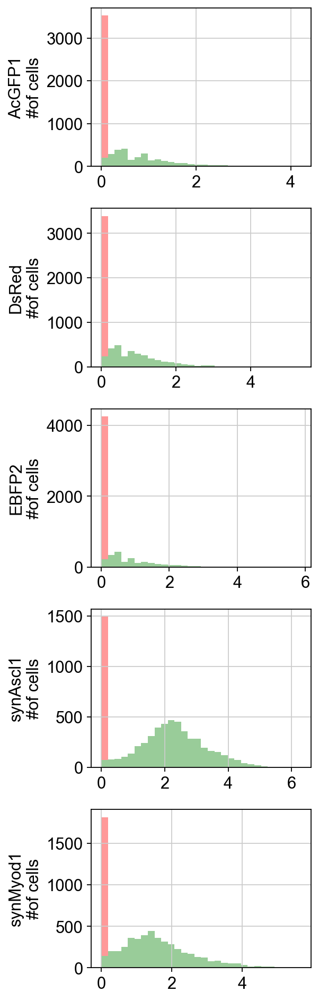

In [67]:
fig, axs = plt.subplots(ncols=1, nrows=5, figsize=(4, 12))
for j, construct in enumerate(constructs_ordered_optim):
    X = adata_rna_proc_assignment.obs[construct + processing + suffix].values.reshape(-1,1)
    model = models[j]

    axs[j].hist(
        [X[adata_rna_proc_assignment.obs[construct + '_positive_gmm'].values, 0], 
         X[adata_rna_proc_assignment.obs[construct + '_positive_gmm'].values==False, 0]
        ], stacked = True, bins = 30, color = ['green','red'], alpha = 0.4
    )
    axs[j].set_ylabel(construct + '\n#of cells')
    if j == 6:
        axs[j].set_xlabel('log counts')
    else:
        axs[j].set_xlabel('')
plt.subplots_adjust(wspace=0.25, hspace=0.25)
plt.tight_layout()
plt.show()

### Initialize group assignments via fraction-based optimization

#### Initialise group membership with target population structure-based optimisation approach

In [68]:
def objective_function(
    optimised_thresholds,
    optimised_thresholds_idx,
    fixed_thresholds,
    fixed_thresholds_idx,
    expression_matrix,
    desired,
    bool_combs,
    ncond,
    ngenes,
):
    """
    """
    #compute the positivity/negativity assignment for all cells for all constructs
    all_thresholds = np.zeros((ngenes,))
    if len(fixed_thresholds_idx) > 0:
        all_thresholds[fixed_thresholds_idx] = fixed_thresholds
    all_thresholds[optimised_thresholds_idx] = optimised_thresholds
    bool_matrix = expression_matrix >= all_thresholds
    
    #compute the number of cells assigned to each of the categories (or less if not all present)
    uniqueValues, occurCount = np.unique(bool_matrix, axis = 0, return_counts = True)
    uniqueValues = list(uniqueValues)
    uniqueValues = [list(x) for x in uniqueValues]
   
    #get the assignments into a vector ordered by our combinations
    true_counts = np.zeros(np.power(2, ncond))
    for i, comb in enumerate(bool_combs):
        for j, uniq in enumerate(uniqueValues):
            if comb == uniq:
                true_counts[i] = occurCount[j]
    
    #define the vector of expected counts per category
    desired_counts = np.concatenate((
        desired, 
        np.zeros(np.power(2, ncond)-ncond)
    ))
    loss = np.sqrt(np.mean(np.square(true_counts - desired_counts)))
    return loss

In [69]:
ncond=6
ngenes=5
fixed_thresholds_from_gmm = []
if bool_recomp:
    from scipy.optimize import differential_evolution
    for i, construct in enumerate(constructs_ordered_optim):
        adata_rna_proc_assignment.obs[construct + '_positive_optim'] = False
    desired = np.repeat(1./ncond, ncond)
    construct_expression_matrix_batch = np.zeros((adata_rna_proc_assignment.shape[0], ngenes))
    for i, construct in enumerate(constructs_ordered_optim):
        construct_expression_matrix_batch[:,i] = adata_rna_proc_assignment.obs[construct + processing + suffix]
    thresholds_fixed = np.array([
        np.min(adata_rna_proc_assignment[
            adata_rna_proc_assignment.obs[x + "_positive_gmm"].values == True
        ].obs[x + processing + suffix].values) 
        for x in constructs_ordered_optim
        if x in fixed_thresholds_from_gmm
    ])
    thresholds_optim_idx = np.array([i for i, x in enumerate(constructs_ordered_optim) if x not in fixed_thresholds_from_gmm])
    thresholds_fixed_idx = np.array([i for i, x in enumerate(constructs_ordered_optim) if x in fixed_thresholds_from_gmm])
    res = differential_evolution(
        func=objective_function, 
        args=(
            thresholds_optim_idx,
            thresholds_fixed,
            thresholds_fixed_idx,
            construct_expression_matrix_batch, 
            desired, 
            bool_combs,
            ncond,
            ngenes,
        ),
        bounds=tuple([(0., 6.) for i in range(ngenes - len(fixed_thresholds_from_gmm))])
    )
    print(res)
    thresholds = np.zeros((ncond,))
    thresholds[thresholds_optim_idx] = res.x
    if len(thresholds_fixed_idx) > 0:
        thresholds[thresholds_fixed_idx] = thresholds_fixed
    for i, construct in enumerate(constructs_ordered_optim):
        adata_rna_proc_assignment.obs[construct + '_positive_optim'] = adata_rna_proc_assignment.obs[construct + processing] > thresholds[i]
        print(f"Mean number of {construct}-positive cells: {np.mean(adata_rna_proc_assignment.obs[construct + '_positive_optim'])}")

     fun: 163.57362479680722
 message: 'Optimization terminated successfully.'
    nfev: 2031
     nit: 26
 success: True
       x: array([0.06556209, 0.04655542, 0.01469327, 1.75774104, 1.07964693])
Mean number of AcGFP1-positive cells: 0.45965809234702026
Mean number of DsRed-positive cells: 0.4872982904617351
Mean number of EBFP2-positive cells: 0.35373062789583
Mean number of synAscl1-positive cells: 0.548969483943122
Mean number of synMyod1-positive cells: 0.5093465409809874


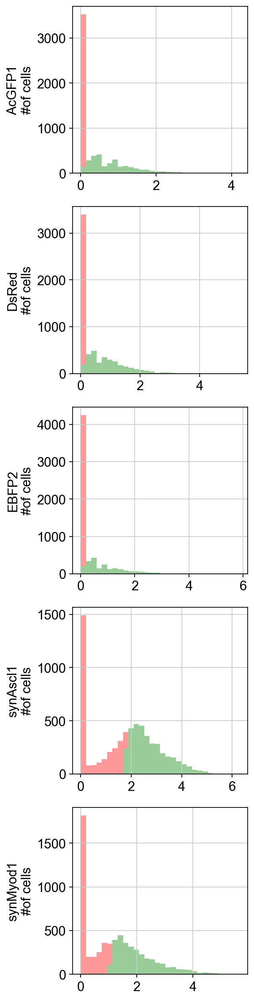

In [70]:
fig, axs = plt.subplots(ncols=1, nrows=5, figsize=(4, 15))
for j, construct in enumerate(constructs_ordered_optim):
    X = adata_rna_proc_assignment.obs[construct + processing + suffix].values.reshape(-1,1)
    model = models[j]

    axs[j].hist(
        [X[adata_rna_proc_assignment.obs[construct + '_positive_optim'].values, 0], 
         X[adata_rna_proc_assignment.obs[construct + '_positive_optim'].values==False, 0]
        ], stacked = True, bins = 30, color = ['green','red'], alpha = 0.4
    )
    axs[j].set_ylabel(construct + '\n#of cells')
    if j == 6:
        axs[j].set_xlabel('log normalized counts')
    else:
        axs[j].set_xlabel('')
plt.subplots_adjust(wspace=0.25, hspace=0.25)
plt.tight_layout()
plt.show()

### Assign cells to conditions based on likelihood under each centroid

In [71]:
choice = "gmm"

In [72]:
group_ids = np.array([False, True])
mean_batch_gene_group = np.array([
    [
        adata_rna_proc_assignment[
            adata_rna_proc_assignment.obs[y + "_positive_" + choice].values == z
        , :].obs[y + processing + suffix].values.mean(axis=0) 
        for z in group_ids
    ]
    for y in constructs_ordered_optim
])
sd_batch_gene_group = np.array([
    [
        #np.maximum(adata_rna_proc_assignment[
        #    adata_rna_proc_assignment.obs[y + "_positive_" + choice].values == z
        #, :].obs[y + processing + suffix].values.std(axis=0), 1e-1)
        1.
        for z in group_ids
    ]
    for y in constructs_ordered_optim
])
ll_cell_gene_group = \
    -0.5*np.log(2*np.pi*np.square(sd_batch_gene_group[:, :])) - \
    0.5 * np.square(
        np.expand_dims(adata_rna_proc_assignment.obs[[y + processing + suffix for y in constructs_ordered_optim]].values, axis=-1) - \
        mean_batch_gene_group[:, :]
    ) / np.square(sd_batch_gene_group[:, :])
ll_cell_condition = np.array([
    np.sum(ll_cell_gene_group[:, np.arange(len(x)), np.expand_dims(x, axis=0)], axis=-1).flatten()
    for x in np.array(bool_combs_real).astype(int)
]).T
del group_ids

categories_real = []
category_assignments_real = ["7) no transgene" for i in range(adata_rna_proc_assignment.shape[0])]
class_assignments = np.argmax(ll_cell_condition, axis=1)
for i, comb in enumerate(bool_combs_real):
    category = str(i+1) + ') ' + ', '.join(["".join(x.split("_transgene")) for j, x in enumerate(constructs_ordered_optim) if comb[j]])
    if np.all([x in category.split(") ")[-1] for x in ["AcGFP1", "DsRed", "Ascl1", "Myod1"]]):
        category = category.split(") ")[0] + ") AcGFP1, DsRed, synmutantAscl1, synMyod1"
    elif np.all([x in category.split(") ")[-1] for x in ["AcGFP1", "Ascl1"]]):
        category = category.split(") ")[0] + ") AcGFP1, synmutantAscl1"
    elif category.split(") ")[-1] == "AcGFP1, DsRed, EBFP2":
        category = "6) empty"
    categories_real.append(category)
        
adata_rna_proc_assignment.obs['inferred_category_real_optim'] = [categories_real[i] for i in class_assignments]
adata_rna_proc.obs['inferred_category_real'] = [
    categories_real[class_assignments[adata_rna_proc_assignment.obs_names.tolist().index(x)]] 
    if x in adata_rna_proc_assignment.obs_names else "7) no transgene"
    for x in adata_rna_proc.obs_names
]
adata_soupx_proc.obs['inferred_category_real'] = [
    categories_real[class_assignments[adata_rna_proc_assignment.obs_names.tolist().index(x)]] 
    if x in adata_rna_proc_assignment.obs_names else "7) no transgene"
    for x in adata_soupx_proc.obs_names
]
adata_atac_proc.obs['inferred_category_real'] = [
    categories_real[class_assignments[adata_rna_proc_assignment.obs_names.tolist().index(x)]] 
    if x in adata_rna_proc_assignment.obs_names else "7) no transgene"
    for x in adata_atac_proc.obs_names
]

# inferred_category_real_reduced does not distinguish empty and no transgene
adata_rna_proc.obs['inferred_category_real_reduced'] = [
    categories_real[class_assignments[adata_rna_proc_assignment.obs_names.tolist().index(x)]] 
    if x in adata_rna_proc_assignment.obs_names else "6) empty"
    for x in adata_rna_proc.obs_names
]
adata_soupx_proc.obs['inferred_category_real_reduced'] = [
    categories_real[class_assignments[adata_rna_proc_assignment.obs_names.tolist().index(x)]] 
    if x in adata_rna_proc_assignment.obs_names else "6) empty"
    for x in adata_soupx_proc.obs_names
]
adata_atac_proc.obs['inferred_category_real_reduced'] = [
    categories_real[class_assignments[adata_rna_proc_assignment.obs_names.tolist().index(x)]] 
    if x in adata_rna_proc_assignment.obs_names else "6) empty"
    for x in adata_atac_proc.obs_names
]

del mean_batch_gene_group
del sd_batch_gene_group
del ll_cell_gene_group
del ll_cell_condition

... storing 'inferred_category_real' as categorical
... storing 'inferred_category_real_reduced' as categorical


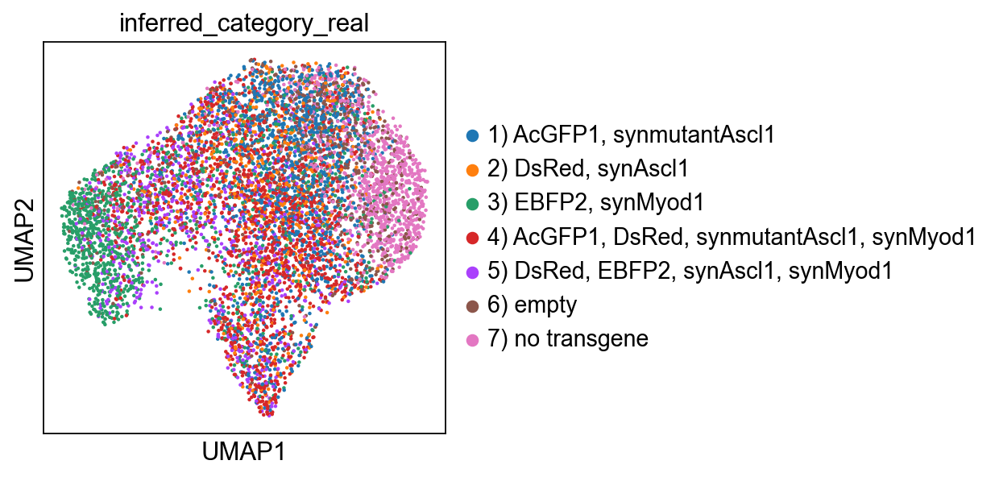

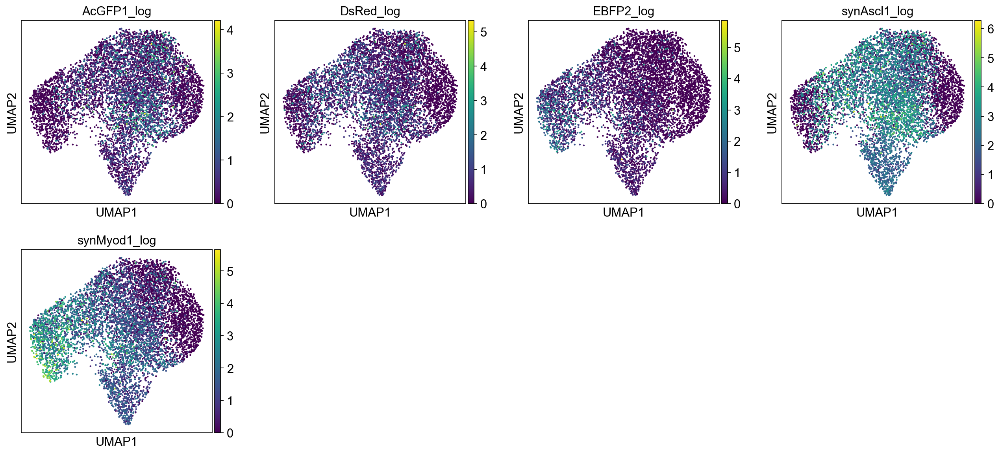

In [73]:
sc.pl.umap(adata_soupx_proc, color='inferred_category_real')
sc.pl.umap(adata_soupx_proc, color=[x + "_log" for x in constructs_ordered_optim])

optim


/var/folders/nt/vpc24jls49g0tskfnpcxg8740000gp/T/ipykernel_11492/4219422884.py:32: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()


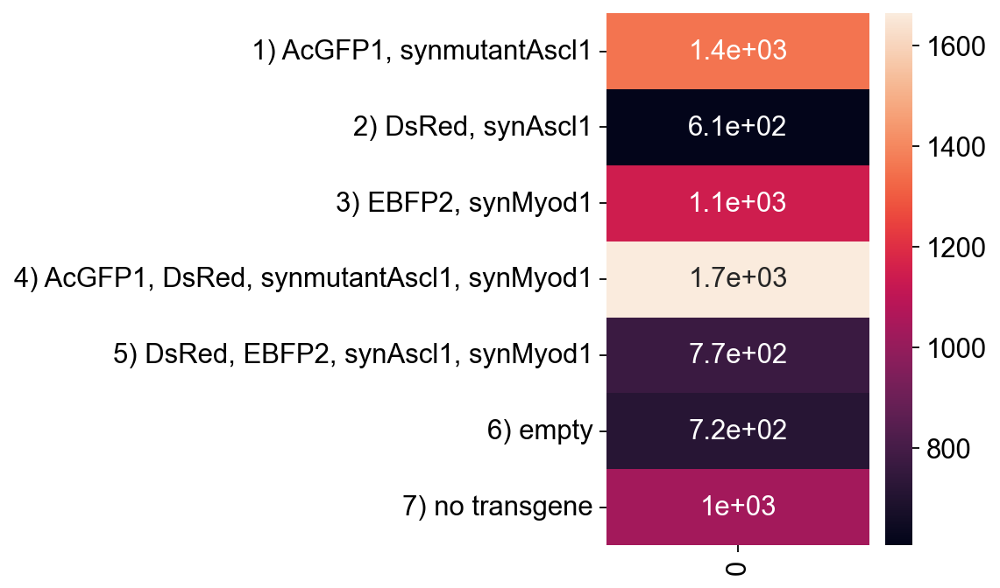

optim

No handles with labels found to put in legend.


/var/folders/nt/vpc24jls49g0tskfnpcxg8740000gp/T/ipykernel_11492/4219422884.py:54: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()


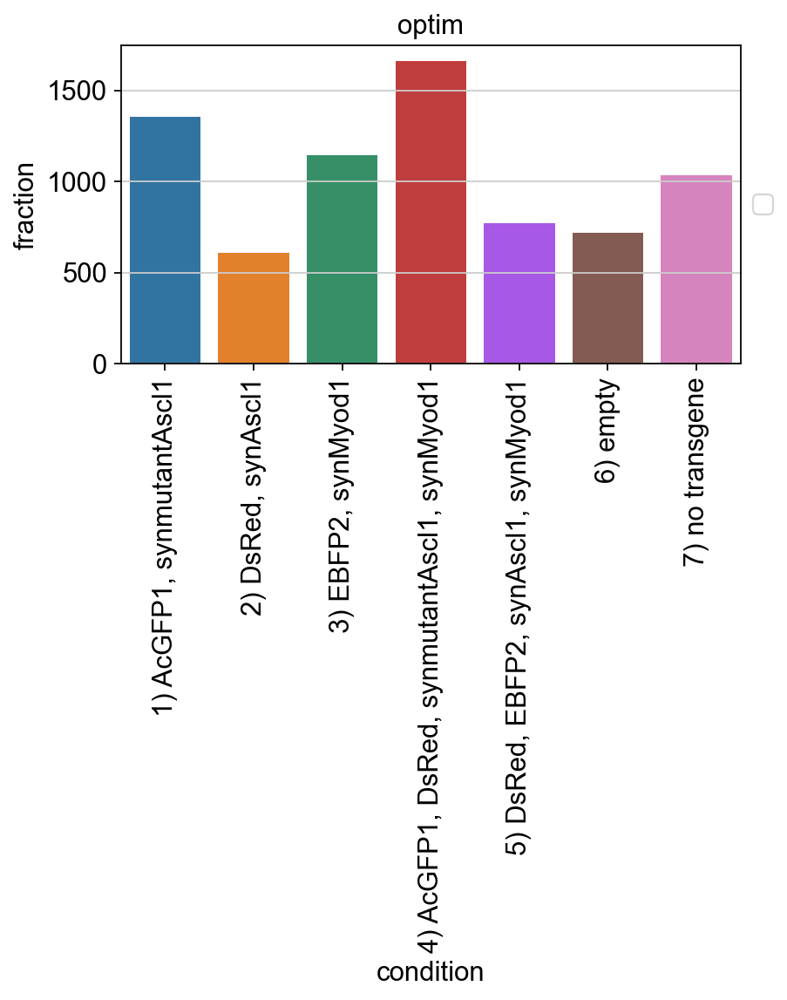

In [74]:
summary_tabs = {}
for method_id in ["optim"]:
    summary_tabs[method_id] = (
        adata_soupx_proc.obs.groupby("inferred_category_real").size()
    ).reset_index()
    summary_tabs[method_id].index = summary_tabs[method_id][
        "inferred_category_real"].values
    del summary_tabs[method_id]["inferred_category_real"]
    # Sort rows
    summary_tabs[method_id] = summary_tabs[method_id].iloc[
        np.argsort([int(str(x).split(")")[0]) for x in summary_tabs[method_id].index])
    ]
    # Remove transgene string from index
    summary_tabs[method_id] = pd.DataFrame(  # revert pivot format
        summary_tabs[method_id].values,
        index=summary_tabs[method_id].index.values,
        columns=summary_tabs[method_id].columns.values.tolist()
    )
    summary_tabs[method_id]["condition"] = summary_tabs[method_id].index.values
# plot heatmaps
for k, v in summary_tabs.items():
    print(k)
    fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(3, 5))
    sb.heatmap(
        v.loc[:, v.columns != "condition"],
        annot=True,
        xticklabels=1, 
        yticklabels=1,
        ax=ax
    )
    ax.xaxis.set_tick_params(rotation=90)
    plt.tight_layout()
    plt.show()
# plot barplots
fig, axs = plt.subplots(ncols=1, nrows=1, figsize=(6, 3))
axs = [axs]
for i, (k, v) in enumerate(summary_tabs.items()):
    print(k)
    v = v.melt(id_vars=["condition"], value_name="fraction")
    sb.barplot(
        data=v,
        x="condition",
        y="fraction",
        ax=axs[i]
    )
    box = axs[i].get_position()
    axs[i].set_title(k)
    axs[i].set_position([box.x0, box.y0, box.width * 0.95, box.height])
    axs[i].legend(loc='center left', bbox_to_anchor=(1, 0.5))
    axs[i].xaxis.set_tick_params(rotation=90)
    if i < len(summary_tabs.items()) - 1:
        axs[i].set_xticks([])
        axs[i].set_xlabel("")
plt.tight_layout()
plt.show()

## Calling top transgene expressing cells

In [75]:
for x in constructs_ordered_optim:
    max_val = np.quantile(adata_rna_proc.obs[x + "_log"].values, q=0.98)
    adata_rna_proc.obs[x + "_log_scaled"] = \
        np.minimum(adata_rna_proc.obs[x + "_log"].values / max_val, 1.)

In [76]:
for x in [
    '1) AcGFP1, synmutantAscl1', 
    '2) DsRed, synAscl1', 
    '3) EBFP2, synMyod1', 
    '4) AcGFP1, DsRed, synmutantAscl1, synMyod1', 
    '5) DsRed, EBFP2, synAscl1, synMyod1',
]:
    transgenes = x.split(") ")[1].split(", ")
    transgenes = [y if y != "synmutantAscl1" else "synAscl1" for y in transgenes]
    vals = adata_rna_proc.obs[[y + "_log_scaled" for y in transgenes]].values.sum(axis=1)
    idx_top = np.argsort(vals)[-500:]
    adata_rna_proc.obs[f'{x} (top)'] = [
        str(i in idx_top)
        for i in range(adata_rna_proc.n_obs) 
    ]

In [77]:
for a in [adata_soupx_proc, adata_atac_proc]:
    for x in [
        '1) AcGFP1, synmutantAscl1', 
        '2) DsRed, synAscl1', 
        '3) EBFP2, synMyod1', 
        '4) AcGFP1, DsRed, synmutantAscl1, synMyod1', 
        '5) DsRed, EBFP2, synAscl1, synMyod1',
    ]:
        a.obs[f'{x} (top)'] = [
            adata_rna_proc.obs.loc[y, f'{x} (top)']
            for y in adata_soupx_proc.obs_names
        ]

## Assigning cells to categories and plotting the categories

... storing '1) AcGFP1, synmutantAscl1 (top)' as categorical
... storing '2) DsRed, synAscl1 (top)' as categorical
... storing '3) EBFP2, synMyod1 (top)' as categorical
... storing '4) AcGFP1, DsRed, synmutantAscl1, synMyod1 (top)' as categorical
... storing '5) DsRed, EBFP2, synAscl1, synMyod1 (top)' as categorical
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed

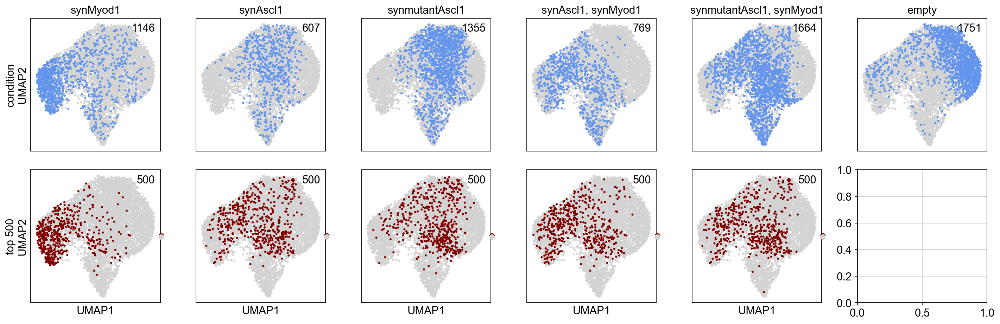

In [78]:
nrow = 2
ncol = 6
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol*3, nrow*3))

if type(axs) != np.ndarray:
    axs = [axs]

for i, category in enumerate([
        '3) EBFP2, synMyod1', 
        '2) DsRed, synAscl1', 
        '1) AcGFP1, synmutantAscl1', 
        '5) DsRed, EBFP2, synAscl1, synMyod1',
        '4) AcGFP1, DsRed, synmutantAscl1, synMyod1', 
        "6) empty",
]):
    sc.pl.umap(
        adata_soupx_proc, 
        color=['inferred_category_real_reduced'], 
        palette = ['cornflowerblue' for x in range(17)], 
        groups = [category], 
        show=False, 
        ax=axs[0, i], 
        legend_fontsize = 0, 
        size = 30
    )
    axs[0, i].set_title("".join("".join("".join(category.split(") ")[1].split("AcGFP1, ")).split("DsRed, ")).split("EBFP2, ")))
    if i > 0:
        axs[0, i].set_ylabel("")
    else:
        axs[0, i].set_ylabel("condition\nUMAP2")
    axs[0, i].set_xlabel("")
    axs[0, i].legend_.remove()
    num = (adata_soupx_proc.obs['inferred_category_real_reduced'].values == category).sum()
    axs[0, i].text(0.96, 0.96, str(num),
        ha='right', va='top', transform= axs[0, i].transAxes)
    if i < 5:
        sc.pl.umap(
            adata_soupx_proc, 
            color=[f'{category} (top)'], 
            palette=['maroon' for x in range(17)], 
            groups = ["True"],
            show=False, 
            ax=axs[1, i], 
            legend_fontsize = 0, 
            size = 30
        )
        if i > 0:
            axs[1, i].set_ylabel("")
        else:
            axs[1, i].set_ylabel("top 500\nUMAP2")
        axs[1, i].set_title("")
        #axs[1, i].legend_.remove()
        axs[1, i].text(0.96, 0.96, str(int(np.sum(adata_soupx_proc.obs[f'{category} (top)'].values == "True"))),
            ha='right', va='top', transform= axs[1, i].transAxes)
plt.tight_layout()
plt.show()

Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt


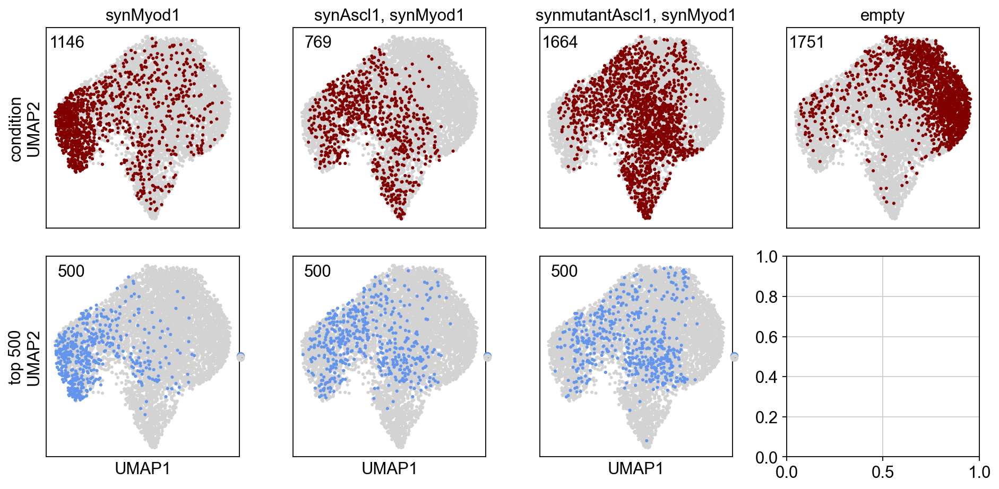

In [79]:
nrow = 2
ncol = 4
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol*3, nrow*3))

if type(axs) != np.ndarray:
    axs = [axs]

for i, category in enumerate([
        '3) EBFP2, synMyod1', 
        '5) DsRed, EBFP2, synAscl1, synMyod1',
        '4) AcGFP1, DsRed, synmutantAscl1, synMyod1', 
        "6) empty",
]):
    sc.pl.umap(
        adata_soupx_proc, 
        color=['inferred_category_real_reduced'], 
        palette = ['maroon' for x in range(17)], 
        groups = [category], 
        show=False, 
        ax=axs[0, i], 
        legend_fontsize = 0, 
        size = 30
    )
    axs[0, i].set_title("".join("".join("".join(category.split(") ")[1].split("AcGFP1, ")).split("DsRed, ")).split("EBFP2, ")))
    if i > 0:
        axs[0, i].set_ylabel("")
    else:
        axs[0, i].set_ylabel("condition\nUMAP2")
    axs[0, i].set_xlabel("")
    axs[0, i].legend_.remove()
    num = (adata_soupx_proc.obs['inferred_category_real_reduced'].values == category).sum()
    axs[0, i].text(0.20, 0.96, str(num),
        ha='right', va='top', transform= axs[0, i].transAxes)
    if i < 3:
        sc.pl.umap(
            adata_soupx_proc, 
            color=[f'{category} (top)'], 
            palette=['cornflowerblue' for x in range(17)], 
            groups = ["True"],
            show=False, 
            ax=axs[1, i], 
            legend_fontsize = 0, 
            size = 30
        )
        if i > 0:
            axs[1, i].set_ylabel("")
        else:
            axs[1, i].set_ylabel("top 500\nUMAP2")
        axs[1, i].set_title("")
        #axs[1, i].legend_.remove()
        axs[1, i].text(0.20, 0.96, str(int(np.sum(adata_soupx_proc.obs[f'{category} (top)'].values == "True"))),
            ha='right', va='top', transform= axs[1, i].transAxes)
plt.tight_layout()
plt.savefig(dir_out + "6b3.pdf")
plt.show()

In [80]:
tab = (
    adata_soupx_proc.obs.groupby(["inferred_category_real_reduced", "louvain_coarse"]).size() / 
    adata_soupx_proc.obs.groupby(["inferred_category_real_reduced"]).size()
).reset_index()
tab.columns = [x if x != 0 else "fraction" for x in tab.columns]
tab = tab.loc[[
    x in [
        "3) EBFP2, synMyod1",
        "4) AcGFP1, DsRed, synmutantAscl1, synMyod1",
        "5) DsRed, EBFP2, synAscl1, synMyod1",
        "6) empty",
    ]
    for x in tab["inferred_category_real_reduced"].values
], :]
tab["inferred_category_real_reduced"] = pd.Categorical(
    [
        {
            "3) EBFP2, synMyod1": "synMyod1",
            "4) AcGFP1, DsRed, synmutantAscl1, synMyod1": "synmutantAscl1, synMyod1",
            "5) DsRed, EBFP2, synAscl1, synMyod1": "synAscl1, synMyod1",
            "6) empty": "empty",
        }[x] for x in tab["inferred_category_real_reduced"].values
    ],
    categories=[
        "synMyod1",
        "synmutantAscl1, synMyod1",
        "synAscl1, synMyod1",
        "empty",
    ]
)
tab["louvain_coarse"] = pd.Categorical(
    tab["louvain_coarse"].values,
    categories=[
        "myogenic",
        "perturbed",
        "control",
    ]
)

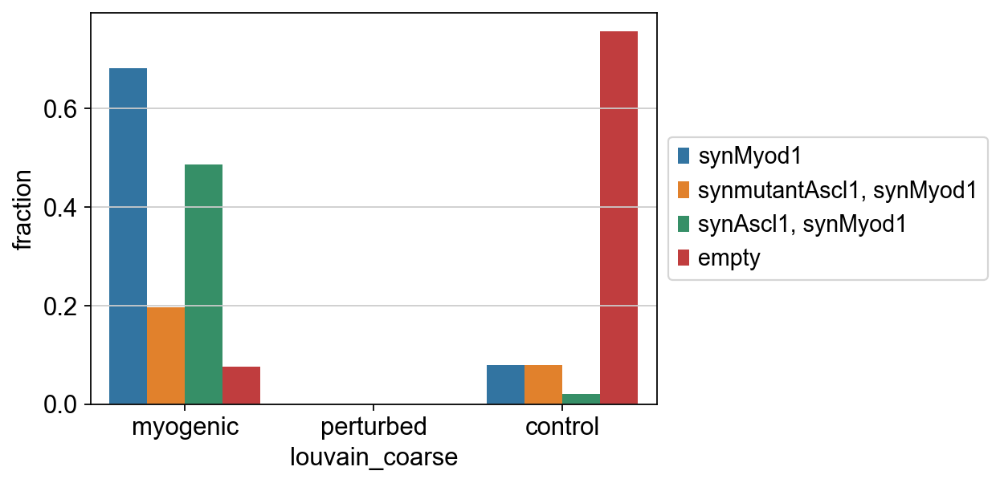

In [81]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
sb.barplot(
    data=tab, 
    hue="inferred_category_real_reduced",
    x="louvain_coarse",
    y="fraction",
    ax=ax
)
ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.tight_layout()
plt.show()

Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt


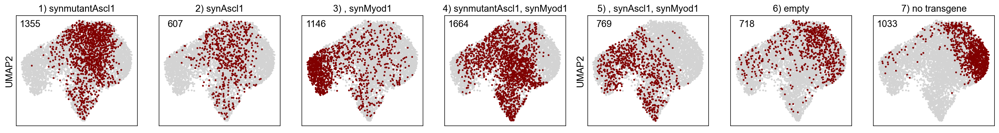

In [82]:
nrow = 1
ncol = 7
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol*3, nrow*3))

if type(axs) != np.ndarray:
    axs = [axs]
else:
    axs = axs.ravel()

for i, category in enumerate(categories_real + ["7) no transgene"]):
    if (adata_soupx_proc.obs['inferred_category_real'].values == category).sum() != 0:
        num = (adata_soupx_proc.obs['inferred_category_real'].values ==  category).sum()
        sc.pl.umap(
            adata_soupx_proc, 
            color=['inferred_category_real'], 
            palette = ['maroon' for x in range(17)], 
            groups = [category], 
            title = "".join("".join("".join(category.split("AcGFP1, ")).split("DsRed, ")).split("EBFP2")), 
            show=False, 
            ax=axs[i], 
            legend_fontsize = 0, 
            size = 30
        )
        if i % 4 > 0:
            axs[i].set_ylabel("")
        if i // 4 < 3:
            axs[i].set_xlabel("")
        axs[i].legend_.remove()
        axs[i].text(0.20, 0.96, str(num),
            ha='right', va='top', transform= axs[i].transAxes)
    else:
        print(category)
plt.tight_layout()
plt.savefig(dir_out + "EV5c1.pdf")
plt.show()

... storing 'inferred_category_real' as categorical
... storing 'inferred_category_real_reduced' as categorical
... storing '1) AcGFP1, synmutantAscl1 (top)' as categorical
... storing '2) DsRed, synAscl1 (top)' as categorical
... storing '3) EBFP2, synMyod1 (top)' as categorical
... storing '4) AcGFP1, DsRed, synmutantAscl1, synMyod1 (top)' as categorical
... storing '5) DsRed, EBFP2, synAscl1, synMyod1 (top)' as categorical
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt


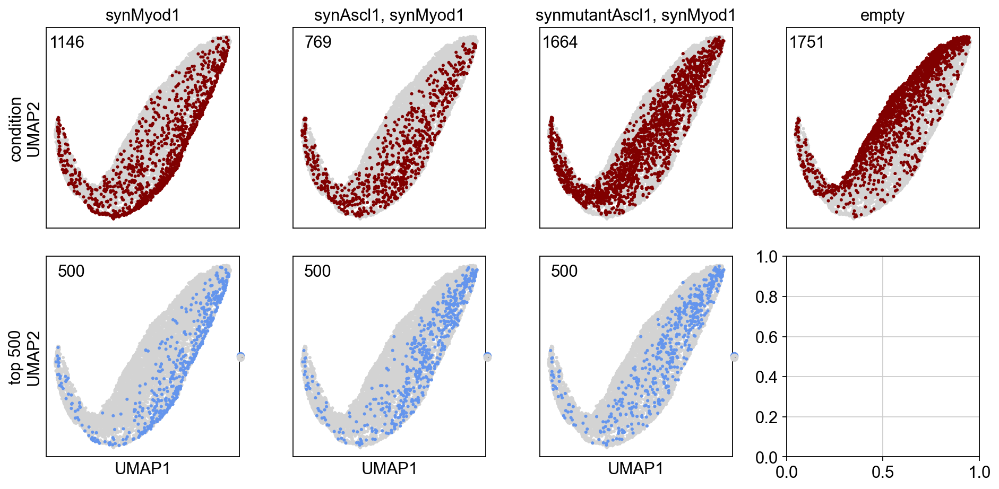

In [83]:
nrow = 2
ncol = 4
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol*3, nrow*3))

if type(axs) != np.ndarray:
    axs = [axs]

for i, category in enumerate([
        '3) EBFP2, synMyod1', 
        '5) DsRed, EBFP2, synAscl1, synMyod1',
        '4) AcGFP1, DsRed, synmutantAscl1, synMyod1', 
        "6) empty",
]):
    sc.pl.umap(
        adata_atac_proc, 
        color=['inferred_category_real_reduced'], 
        palette = ['maroon' for x in range(17)], 
        groups = [category], 
        show=False, 
        ax=axs[0, i], 
        legend_fontsize = 0, 
        size = 30
    )
    axs[0, i].set_title("".join("".join("".join(category.split(") ")[1].split("AcGFP1, ")).split("DsRed, ")).split("EBFP2, ")))
    if i > 0:
        axs[0, i].set_ylabel("")
    else:
        axs[0, i].set_ylabel("condition\nUMAP2")
    axs[0, i].set_xlabel("")
    axs[0, i].legend_.remove()
    num = (adata_atac_proc.obs['inferred_category_real_reduced'].values == category).sum()
    axs[0, i].text(0.20, 0.96, str(num),
        ha='right', va='top', transform= axs[0, i].transAxes)
    if i < 3:
        sc.pl.umap(
            adata_atac_proc, 
            color=[f'{category} (top)'], 
            palette=['cornflowerblue' for x in range(17)], 
            groups = ["True"],
            show=False, 
            ax=axs[1, i], 
            legend_fontsize = 0, 
            size = 30
        )
        if i > 0:
            axs[1, i].set_ylabel("")
        else:
            axs[1, i].set_ylabel("top 500\nUMAP2")
        axs[1, i].set_title("")
        axs[1, i].text(0.20, 0.96, str(int(np.sum(adata_atac_proc.obs[f'{category} (top)'].values == "True"))),
            ha='right', va='top', transform= axs[1, i].transAxes)
plt.tight_layout()
plt.savefig(dir_out + "6b4.pdf")
plt.show()

Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt


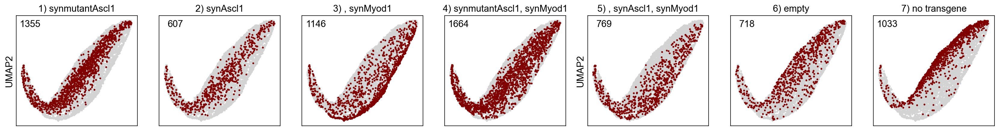

In [84]:
nrow = 1
ncol = 7
fig, axs = plt.subplots(nrow, ncol, figsize=(ncol*3, nrow*3))

if type(axs) != np.ndarray:
    axs = [axs]
else:
    axs = axs.ravel()

for i, category in enumerate(categories_real + ["7) no transgene"]):
    if (adata_atac_proc.obs['inferred_category_real'].values == category).sum() != 0:
        num = (adata_atac_proc.obs['inferred_category_real'].values ==  category).sum()
        sc.pl.umap(
            adata_atac_proc, 
            color=['inferred_category_real'], 
            palette = ['maroon' for x in range(17)], 
            groups = [category], 
            title = "".join("".join("".join(category.split("AcGFP1, ")).split("DsRed, ")).split("EBFP2")), 
            show=False, 
            ax=axs[i], 
            legend_fontsize = 0, 
            size = 30
        )
        if i % 4 > 0:
            axs[i].set_ylabel("")
        if i // 4 < 3:
            axs[i].set_xlabel("")
        axs[i].legend_.remove()
        axs[i].text(0.20, 0.96, str(num),
            ha='right', va='top', transform= axs[i].transAxes)
    else:
        print(category)
plt.tight_layout()
plt.savefig(dir_out + "EV5c2.pdf")
plt.show()

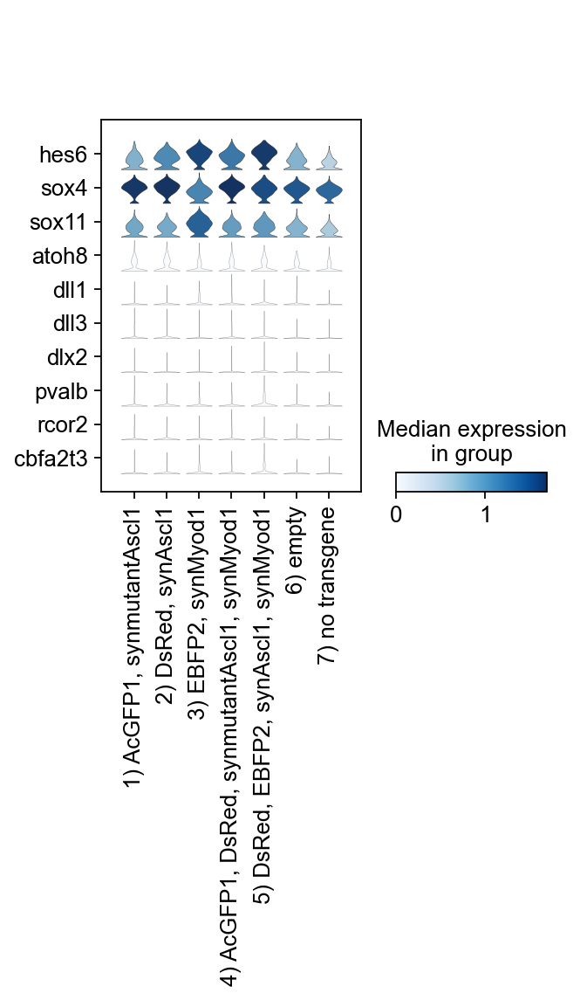

In [85]:
sc.pl.stacked_violin(
    adata_soupx_proc, swap_axes=True,
    var_names=['hes6', 'sox4','sox11', 'atoh8', 'dll1','dll3', 'dlx2',
               'pvalb','rcor2','cbfa2t3'],
    groupby="inferred_category_real"
)

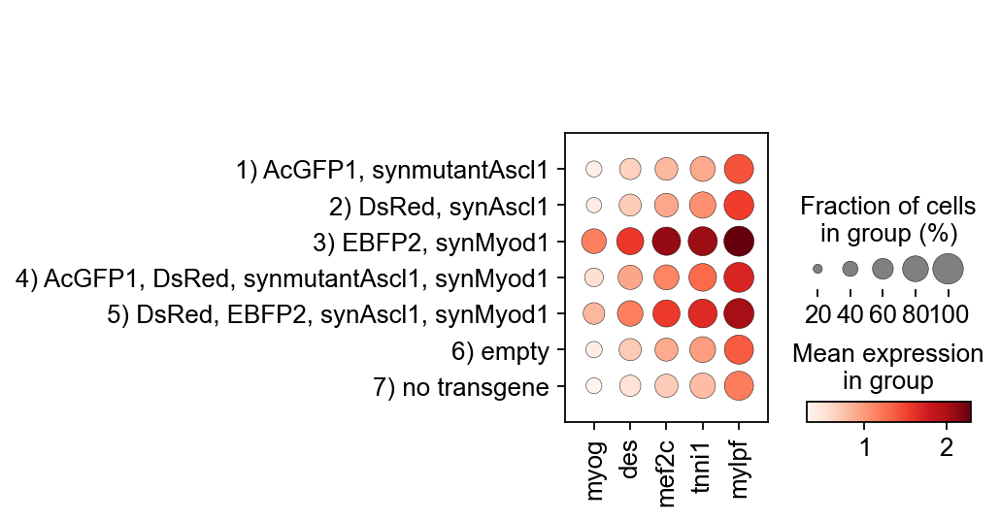

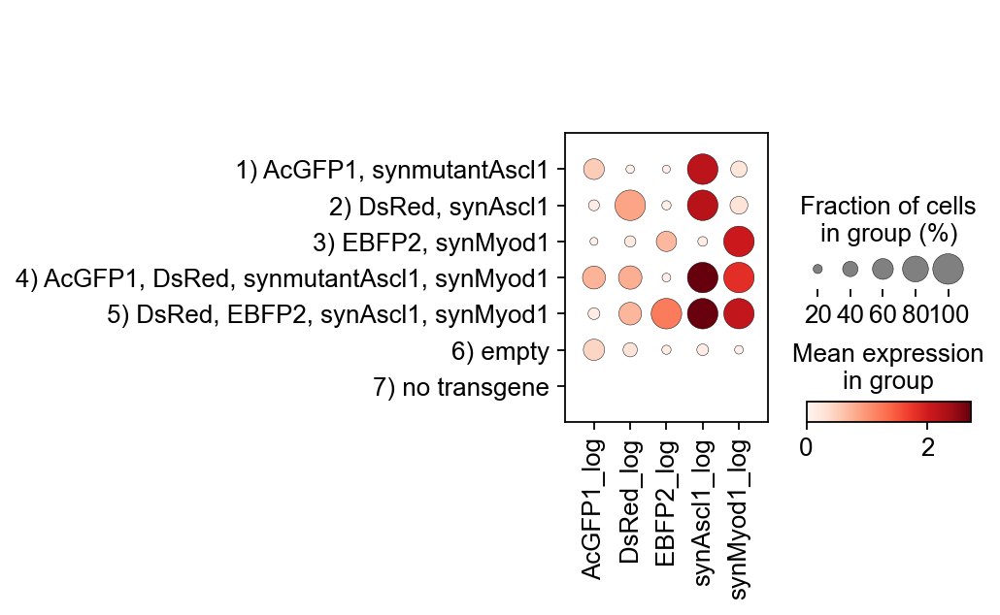

In [86]:
sc.pl.dotplot(
    adata_soupx_proc, 
    var_names=downstream_genes,
    groupby="inferred_category_real")
sc.pl.dotplot(
    adata_soupx_proc, 
    var_names=[x + "_log" for x in constructs_ordered_optim],
    groupby="inferred_category_real")

# DE between conditions

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


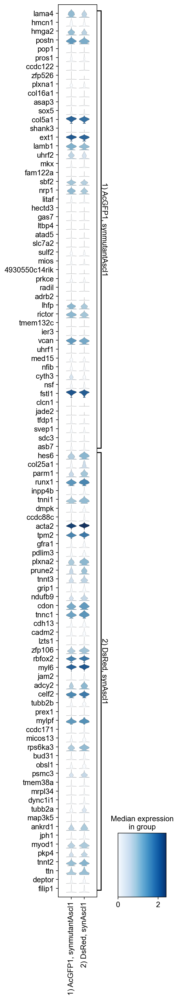

In [87]:
adata_de = adata_soupx_proc[[
    x in ['1) AcGFP1, synmutantAscl1', '2) DsRed, synAscl1']
    for x in adata_soupx_proc.obs["inferred_category_real"].values
], :].copy()
sc.tl.rank_genes_groups(adata_de, groupby="inferred_category_real")
sc.pl.rank_genes_groups_stacked_violin(
    adata_de, n_genes=50, swap_axes=True, figsize=(3, 25)
)
pd.DataFrame(dict([
    (k, [x[0] for x in adata_de.uns["rank_genes_groups"][k]]) 
    for k in ["names", "scores", "pvals", "pvals_adj", "logfoldchanges"]
])).to_csv(dir_out + "multiome_stackedviolin_de_ascl1_mascl1.csv", sep=";")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


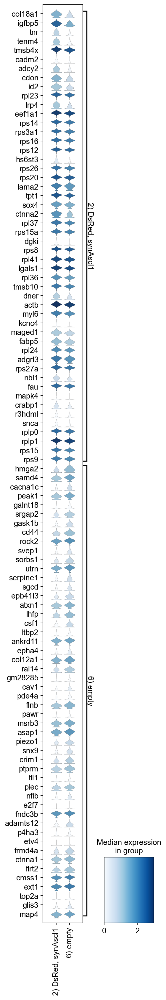

In [88]:
adata_de = adata_soupx_proc[[
    x in ['6) empty', '2) DsRed, synAscl1']
    for x in adata_soupx_proc.obs["inferred_category_real"].values
], :].copy()
sc.tl.rank_genes_groups(adata_de, groupby="inferred_category_real")
sc.pl.rank_genes_groups_stacked_violin(
    adata_de, n_genes=50, swap_axes=True, figsize=(3, 25)
)
pd.DataFrame(dict([
    (k, [x[0] for x in adata_de.uns["rank_genes_groups"][k]]) 
    for k in ["names", "scores", "pvals", "pvals_adj", "logfoldchanges"]
])).to_csv(dir_out + "multiome_stackedviolin_de_ascl1_empty.csv", sep=";")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


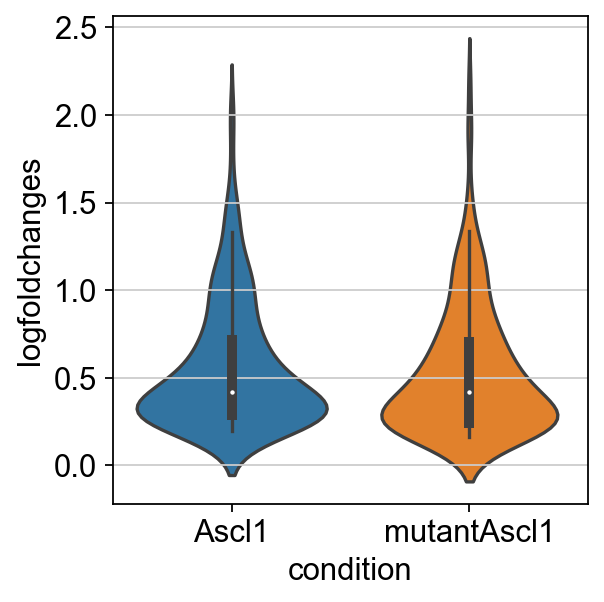

In [89]:
adata_de0 = adata_soupx_proc[[
    x in ['6) empty', '2) DsRed, synAscl1']
    for x in adata_soupx_proc.obs["inferred_category_real"].values
], :].copy()
sc.tl.rank_genes_groups(adata_de0, groupby="inferred_category_real")
adata_de1 = adata_soupx_proc[[
    x in ['6) empty', '1) AcGFP1, synmutantAscl1']
    for x in adata_soupx_proc.obs["inferred_category_real"].values
], :].copy()
sc.tl.rank_genes_groups(adata_de1, groupby="inferred_category_real")
tab0 = pd.DataFrame(dict([
    (k, [x[0] for x in adata_de0.uns["rank_genes_groups"][k]]) 
    for k in ["names", "scores", "pvals", "pvals_adj", "logfoldchanges"]
]))
tab0.index = tab0["names"].values
tab1 = pd.DataFrame(dict([
    (k, [x[0] for x in adata_de1.uns["rank_genes_groups"][k]]) 
    for k in ["names", "scores", "pvals", "pvals_adj", "logfoldchanges"]
]))
tab1.index = tab0["names"].values
topn = 200
tab = pd.concat([pd.DataFrame({
    "genes": tab0["names"].values[:topn],
    "logfoldchanges": x.loc[tab0["names"].values[:topn], "logfoldchanges"],
    "condition": [k for _ in range(topn)]
}) for k, x in {"Ascl1": tab0, "mutantAscl1": tab1}.items()], axis=0)
sb.violinplot(data=tab, x="condition", y="logfoldchanges")
plt.tight_layout()
plt.show()

# Save final versions of processed objects

In [90]:
# Format bool as str so that it can be saved.
for a in [adata_rna_filtered, adata_rna_proc, adata_soupx_proc, adata_atac_proc, adata_rnaatac_proc]:
    for i, construct in enumerate(constructs_ordered_optim):
        y = construct + '_positive_optim'
        if y in a.obs.columns:
            vals = [str(x) for x in a.obs[y].values]
            del a.obs[y]
            a.obs[y] = vals

In [91]:
if bool_recomp:
    sc.write(dir_anndata+'adata_rna_filtered.h5ad', adata_rna_filtered)
    sc.write(dir_anndata+'adata_rna_proc.h5ad', adata_rna_proc)
    sc.write(dir_anndata+'adata_soupx_proc.h5ad', adata_soupx_proc)
    sc.write(dir_anndata+'adata_atac_proc.h5ad', adata_atac_proc)
    sc.write(dir_anndata+'adata_rnaatac_proc.h5ad', adata_rnaatac_proc)

... storing 'inferred_category_real' as categorical
... storing 'inferred_category_real_reduced' as categorical
... storing '1) AcGFP1, synmutantAscl1 (top)' as categorical
... storing '2) DsRed, synAscl1 (top)' as categorical
... storing '3) EBFP2, synMyod1 (top)' as categorical
... storing '4) AcGFP1, DsRed, synmutantAscl1, synMyod1 (top)' as categorical
... storing '5) DsRed, EBFP2, synAscl1, synMyod1 (top)' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'gene' as categorical
... storing 'distance' as categorical
... storing 'peak_type' as categorical
